<h1>Machine Learning - Binary Classification project </h1>

<h3>Ofir Haim, Veronica Iovchik</h3>

<h5> June, 2021</h5>

<h3>Introduction</h3>

<h5>The number of Online e-commarce stores  has been expended exponnecially dramatically in recent years, Except for the users' advantages of how the E-commerce market affects purchasers, Vendors and E-commerce owners can gather, analyze, and track customer behavior across the online platform in order to meet their marketing objectives.</h5>
<h5>As part of our final machine learning project, we'd like to reliably anticipate sales and demand. We employ sales, marketing, and user behavior indicators as fields in our database to see how we can estimate sales impact.
</h5>
<h5>Binary classification is a type of classification that restricts the output to two classes. It is used to predict categorical variables. In our example, we'll categorize the results by whether they were purchased or not.</h5>

**Assumptions**

<ol>
  <li> Our available dataset examples are independent and identically distributed, according to an unknown probability distribution</li>
  <li>Each of the training data points consists of a set of vectors and a class label associated with each vector.
</li>
  <li>Fixed regressors- the variables,the input data, are not random variables but fixed numbers and that if we rerun the experiment, we expect the same results.</li>
</ol>

<h3>Project Plan</h3>

<li>Data Exploration</li>
<li>Exploratoty Data Analysis </li>
<li>Data Pre-processing</li>
<li>Dimentionly reduction</li>
<li>Predictive Modelling</li>
<li>Project Evaluation</li>
<li> Findel Pipline </li>


<h3>Data Exploration</h3>


**Importing essential libraries**

In [464]:
import pandas as pd
import numpy as np
import csv
from numpy import nan
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from typing import List, Dict
import math
import warnings
warnings.filterwarnings('ignore')

import plotly.graph_objs as pltl
import plotly.express as pltx
import plotly.express as px
import plotly.figure_factory as ff
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import mean_squared_error, classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import roc_curve,auc
from sklearn.model_selection import train_test_split, KFold
from sklearn.datasets import fetch_openml
from sklearn.linear_model import LogisticRegression,LinearRegression
from sklearn.metrics import r2_score as R2
from sklearn.metrics import precision_recall_curve

from sklearn.preprocessing import StandardScaler
from sklearn import svm  
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score


**Read datset**

In [465]:
data = pd.read_csv("train.csv")
data_test = pd.read_csv("test.csv")

*Preliminary data analysis*

In [466]:
data.head()

,id,num_of_admin_pages,admin_page_duration,num_of_info_pages,info_page_duration,num_of_product_pages,product_page_duration,total_duration,BounceRates,ExitRates,...,device,internet_browser,Region,user_type,Weekend,A,B,C,D,purchase
0,0,0.0,0.0,0.0,0.0 minutes,1.0,0.0 minutes,NaN,0.200000,0.200000,...,1.0,safari_15,1.0,Returning_Visitor,False,c_1,118.880094,log202,NaN,0
1,1,0.0,0.0,0.0,0.0 minutes,1.0,0.0 minutes,0.000000,0.200000,0.200000,...,4.0,safari_14,9.0,Returning_Visitor,False,c_3,113.358423,log404,NaN,0
2,2,0.0,0.0,0.0,NaN,NaN,627.5 minutes,627.500000,0.020000,0.050000,...,3.0,browser_3_v17,1.0,Returning_Visitor,True,c_4,121.507695,log202,NaN,0
3,3,0.0,0.0,0.0,0.0 minutes,19.0,154.2166667 minutes,154.216667,0.015789,0.024561,...,2.0,chrome_99.1.3,1.0,Returning_Visitor,False,c_3,93.747176,log_100,NaN,0
4,4,0.0,0.0,0.0,0.0 minutes,1.0,0.0 minutes,NaN,0.200000,0.200000,...,2.0,edge_96.0.1054.75,3.0,Returning_Visitor,False,c_3,99.545824,log202,NaN,0


*Call X,y values and labels*

In [467]:
X, y = data.values[:,:-1], data.values[:, -1]
X_test= data_test.values[:,:-1]

In [468]:
#for pipeline
def create_xy(d,dt):
    X, y = d.values, d.values[:, -1]
    X_test= dt.values
    return X, y,X_test



*Shape of Dataset*

In [469]:
print(f'Our X shape is: {X.shape} and Our Y shape is: {y.shape[0]}')

Our X shape is: (10479, 22) and Our Y shape is: 10479


In [470]:
print(f'Our X Test shape is: {X_test.shape}')

Our X Test shape is: (1851, 21)


*Data types*

In [471]:
data.dtypes

id                         int64
num_of_admin_pages       float64
admin_page_duration      float64
num_of_info_pages        float64
info_page_duration        object
num_of_product_pages     float64
product_page_duration     object
total_duration           float64
BounceRates              float64
ExitRates                float64
PageValues               float64
closeness_to_holiday     float64
Month                     object
device                   float64
internet_browser          object
Region                   float64
user_type                 object
Weekend                   object
A                         object
B                        float64
C                         object
D                        float64
purchase                   int64
dtype: object

<li>Our dataset contains 10479 rows and 22 features (21 features without ID column)</li>
<li>We have 13 features of type "float64" and 9 features of objects type in total.</li>
<li>Our label is a int64 type , purchase column.</li>

*Print out all the colomun from object type, in order to handle those unnumeric values*

In [472]:
all_cols = data.columns
numeric_cols = list(data.select_dtypes(include=[np.number]).columns)[1:]
cat_cols = list(set(all_cols) - set(numeric_cols))

print('-------------------------------------------------------------------------------------------------------------------')
print(f'Our Numeric type columns are - {numeric_cols}')
print('-------------------------------------------------------------------------------------------------------------------')
print(f'Our Object type columns are - {cat_cols}')
print('-------------------------------------------------------------------------------------------------------------------')


-------------------------------------------------------------------------------------------------------------------
Our Numeric type columns are - ['num_of_admin_pages', 'admin_page_duration', 'num_of_info_pages', 'num_of_product_pages', 'total_duration', 'BounceRates', 'ExitRates', 'PageValues', 'closeness_to_holiday', 'device', 'Region', 'B', 'D', 'purchase']
-------------------------------------------------------------------------------------------------------------------
Our Object type columns are - ['id', 'product_page_duration', 'user_type', 'C', 'Weekend', 'internet_browser', 'Month', 'A', 'info_page_duration']
-------------------------------------------------------------------------------------------------------------------


*Dataset description*

In [473]:
data.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
id,10479.0,NaN,NaN,NaN,5239.0,3025.17107,0.0,2619.5,5239.0,7858.5,10478.0
num_of_admin_pages,9874.0,NaN,NaN,NaN,2.321957,3.335331,0.0,0.0,1.0,4.0,27.0
admin_page_duration,10066.0,NaN,NaN,NaN,80.462468,179.217548,0.0,0.0,8.0,93.0,3398.75
num_of_info_pages,9792.0,NaN,NaN,NaN,0.502655,1.265812,0.0,0.0,0.0,0.0,24.0
info_page_duration,10162,1089,0.0 minutes,8176,NaN,NaN,NaN,NaN,NaN,NaN,NaN
num_of_product_pages,10076.0,NaN,NaN,NaN,31.870187,44.816259,0.0,7.0,18.0,38.0,705.0
product_page_duration,9858,7803,0.0 minutes,594,NaN,NaN,NaN,NaN,NaN,NaN,NaN
total_duration,5726.0,NaN,NaN,NaN,1302.457216,2039.312905,0.0,221.0,677.851191,1605.733333,47850.92068
BounceRates,10457.0,NaN,NaN,NaN,0.021854,0.0481,0.0,0.0,0.002968,0.016667,0.2
ExitRates,10453.0,NaN,NaN,NaN,0.042859,0.048297,0.0,0.014283,0.025161,0.05,0.2


At this stage, we can examine our catergorical characteristics to see if they require numric conversion.
<li>We also reviewd a considerable percentage of Nan value, which we should dealt with prior to training our model.
Those indicators were also included in the normalization procedure deisicion we wanted to use. Min<> The Max technique normalizes data using the min and max values, however our results span a wide range, and we've discovered that the method doesn't handle outliers well.</li>

<li>Data with missing values Most of the columns (see “Fill missing values” section).</li>
<li>different numeric values with different scales of numeric ("standartizations").</li>
<li>Categorical section to clean and prepare objects variables to a data type that can be worked with.</li>


**Purchase column**

In [474]:
data['purchase'].value_counts(normalize=True)

0    0.84531
1    0.15469
Name: purchase, dtype: float64

84.5% of our train data is false (user not purchased), while 15.4 is Ture(user purchased)

<h4>View all dublicate row</h4>

In [475]:
duplicated_data =data.duplicated()
duplicated_data.sum() 
data[duplicated_data]

,id,num_of_admin_pages,admin_page_duration,num_of_info_pages,info_page_duration,num_of_product_pages,product_page_duration,total_duration,BounceRates,ExitRates,...,device,internet_browser,Region,user_type,Weekend,A,B,C,D,purchase


We want to make sure that we're not training and forecasting based on unreliable data with duplicated rows. We can observe that there are no duplicated rows.

**Removing 'ID' column**

In [476]:
data.drop(labels=["id"],axis=1,inplace=True)

In [477]:
data_test.drop(labels=["id"],axis=1,inplace=True)

In [478]:
data.head()

,num_of_admin_pages,admin_page_duration,num_of_info_pages,info_page_duration,num_of_product_pages,product_page_duration,total_duration,BounceRates,ExitRates,PageValues,...,device,internet_browser,Region,user_type,Weekend,A,B,C,D,purchase
0,0.0,0.0,0.0,0.0 minutes,1.0,0.0 minutes,NaN,0.200000,0.200000,0.0,...,1.0,safari_15,1.0,Returning_Visitor,False,c_1,118.880094,log202,NaN,0
1,0.0,0.0,0.0,0.0 minutes,1.0,0.0 minutes,0.000000,0.200000,0.200000,0.0,...,4.0,safari_14,9.0,Returning_Visitor,False,c_3,113.358423,log404,NaN,0
2,0.0,0.0,0.0,NaN,NaN,627.5 minutes,627.500000,0.020000,0.050000,0.0,...,3.0,browser_3_v17,1.0,Returning_Visitor,True,c_4,121.507695,log202,NaN,0
3,0.0,0.0,0.0,0.0 minutes,19.0,154.2166667 minutes,154.216667,0.015789,0.024561,0.0,...,2.0,chrome_99.1.3,1.0,Returning_Visitor,False,c_3,93.747176,log_100,NaN,0
4,0.0,0.0,0.0,0.0 minutes,1.0,0.0 minutes,NaN,0.200000,0.200000,0.0,...,2.0,edge_96.0.1054.75,3.0,Returning_Visitor,False,c_3,99.545824,log202,NaN,0


<h3>Exploratory Data Analysis</h3>

In [479]:
corr = data.corr()
corr

,num_of_admin_pages,admin_page_duration,num_of_info_pages,num_of_product_pages,total_duration,BounceRates,ExitRates,PageValues,closeness_to_holiday,device,Region,B,D,purchase
num_of_admin_pages,1.000000,0.591505,0.383974,0.436619,0.447180,-0.222772,-0.317713,0.102648,-0.099734,-0.010604,-0.007737,-0.016465,-0.197337,0.145048
admin_page_duration,0.591505,1.000000,0.297256,0.291797,0.445325,-0.141197,-0.202072,0.068009,-0.072091,-0.011671,-0.003730,-0.018782,-0.110871,0.097504
num_of_info_pages,0.383974,0.297256,1.000000,0.382615,0.489927,-0.116471,-0.165944,0.046150,-0.051921,-0.011148,-0.032790,-0.021416,-0.167875,0.095563
num_of_product_pages,0.436619,0.291797,0.382615,1.000000,0.877881,-0.202365,-0.292254,0.057020,-0.027799,0.000877,-0.043437,-0.019066,-0.326672,0.157167
total_duration,0.447180,0.445325,0.489927,0.877881,1.000000,-0.192154,-0.265104,0.054231,-0.049315,-0.007370,-0.046022,-0.026004,-0.236378,0.145429
BounceRates,-0.222772,-0.141197,-0.116471,-0.202365,-0.192154,1.000000,0.911589,-0.116746,0.081161,0.024877,-0.008510,0.008744,0.147855,-0.150683
ExitRates,-0.317713,-0.202072,-0.165944,-0.292254,-0.265104,0.911589,1.000000,-0.172314,0.111041,0.015076,-0.009308,0.007393,0.231711,-0.207804
PageValues,0.102648,0.068009,0.046150,0.057020,0.054231,-0.116746,-0.172314,1.000000,-0.062112,0.019302,0.010091,-0.012400,-0.447703,0.486404
closeness_to_holiday,-0.099734,-0.072091,-0.051921,-0.027799,-0.049315,0.081161,0.111041,-0.062112,1.000000,0.018269,-0.012651,-0.005234,0.171953,-0.083926
device,-0.010604,-0.011671,-0.011148,0.000877,-0.007370,0.024877,0.015076,0.019302,0.018269,1.000000,0.077885,0.004767,-0.130045,-0.020196


In [480]:
fig =pltx.imshow(corr,width=800,height=750, aspect='auto', color_continuous_scale='blues', title='correlation heatmap')
fig.show()

<h3>From our corraletion table and correlation metrics we observed several intresting insights :</h3>
<br>

<li>PageValue is an essential quality that, although showing the most positive connection with our label, shows that having more product pages increases the likelihood of selling a product.
</li>
<br>
<li>The purchase label has a negative association with the 'D' sign</li>
<br>

<li>ExitRates and BounceRates have a strong link; we may use this correlation when dealing with dimension reduction.</li>
<br>

<li>The number of product pages and overall length have a strong link; this makes sense because the more product pages a user visits, the more time a user spends in the session.</li>
<br>



<AxesSubplot:xlabel='D', ylabel='Count'>

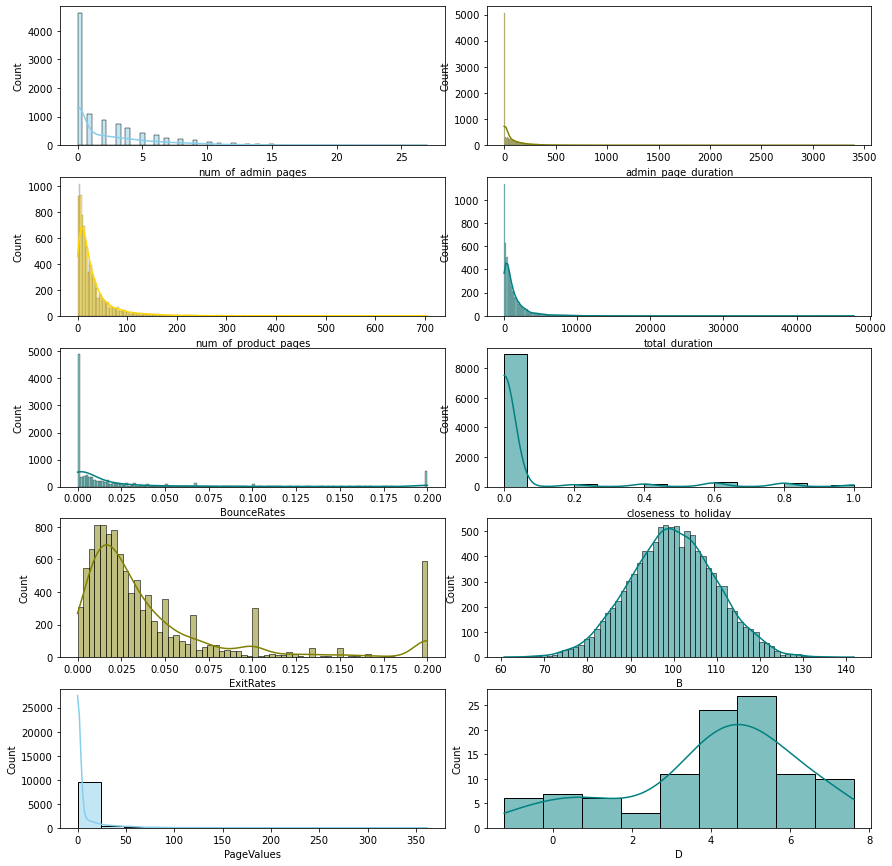

In [481]:
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(12, 12))
fig.tight_layout()
sns.histplot(data=data, x="num_of_admin_pages", kde=True, color="skyblue", ax=axs[0, 0])
sns.histplot(data=data, x="admin_page_duration", kde=True, color="olive", ax=axs[0, 1])
sns.histplot(data=data, x="num_of_product_pages", kde=True, color="gold", ax=axs[1, 0])
sns.histplot(data=data, x="total_duration", kde=True, color="teal", ax=axs[1, 1])
sns.histplot(data=data, x="BounceRates", kde=True, color="teal", ax=axs[2, 0])
sns.histplot(data=data, x="closeness_to_holiday", kde=True, color="teal", ax=axs[2, 1])
sns.histplot(data=data, x="ExitRates", kde=True, color="olive", ax=axs[3, 0])
sns.histplot(data=data, x="B", kde=True, color="teal", ax=axs[3, 1])
sns.histplot(data=data, x="PageValues", kde=True, color="skyblue", ax=axs[4, 0])
sns.histplot(data=data, x="D", kde=True, color="teal", ax=axs[4, 1])


<h4>from count plot we figure our intersting charchirstimis on our dataset and features</h4>
<li>We discovered that BounceRates account for more than half of all '0' observations</li>
<li>the number of admin pare grouped with about 40% don’t have any admin info pages</li>
<li>B feature has normal distribution with a mean of about 100</li>

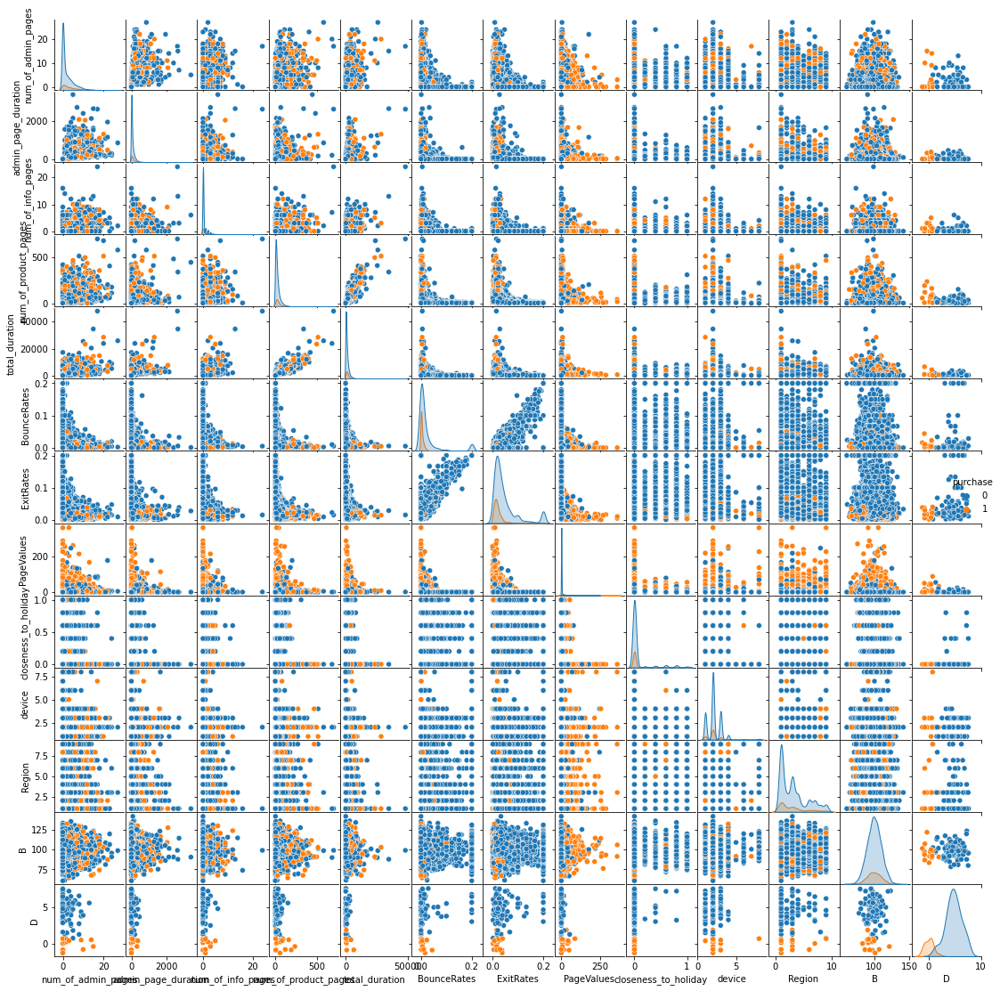

In [482]:
x = sns.pairplot(data[numeric_cols], hue='purchase', size=8).fig.set_size_inches(15,15)

We noticed some features that had a stronger correlation, so we decided to investigate their interactions.
<li>For example, we can see in the correlation of pagesValue and the other feature, that the orange datapoints appear to be dominating in the distribution on the positive corr, based on our observation from the correaltion metrix above
</li>
<li>We can observe the categorial aspect that may be perplexing while they are unite distributed at this point, but the categoriel does not indicate idiction at this time.</li> 
<li>We can observe that the bounce rate and exit rate are related for both purchase and non-purchase data, and that they are dispersed similarly to other features.</li> 

<AxesSubplot:ylabel='Density'>

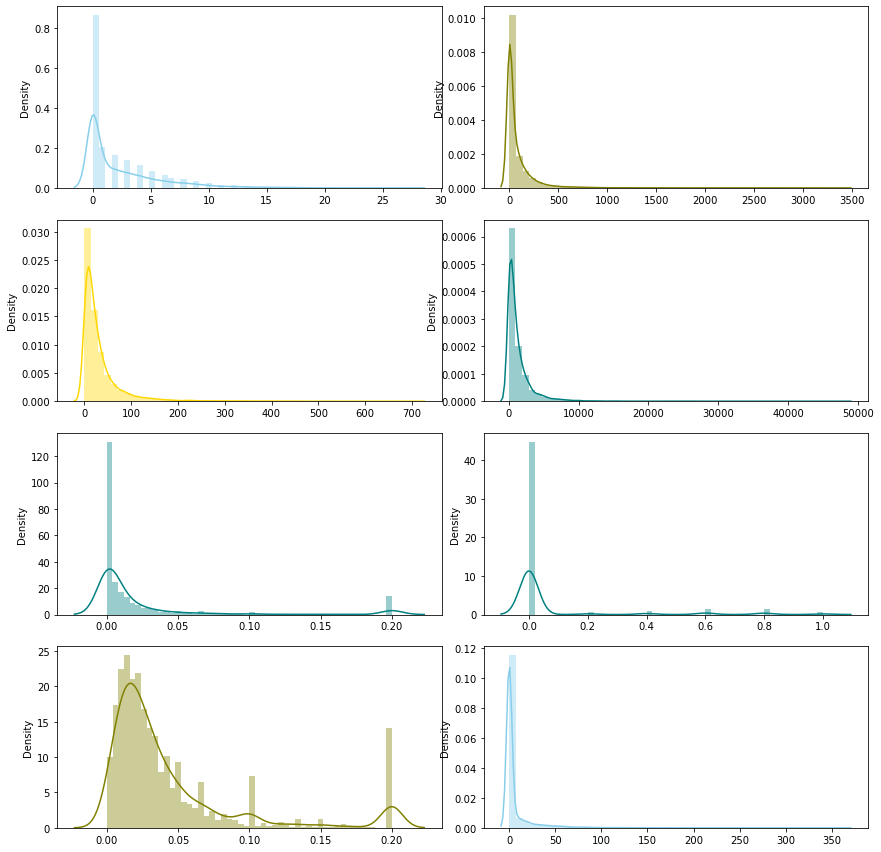

In [483]:
fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(12, 12))
fig.tight_layout()
sns.distplot(x=data["num_of_admin_pages"],  kde=True, color="skyblue", ax=axs[0, 0])
sns.distplot(x=data["admin_page_duration"], kde=True, color="olive", ax=axs[0, 1])
sns.distplot(x=data["num_of_product_pages"], kde=True, color="gold", ax=axs[1, 0])
sns.distplot(x=data["total_duration"], kde=True, color="teal", ax=axs[1, 1])
sns.distplot(x=data["BounceRates"], kde=True, color="teal", ax=axs[2, 0])
sns.distplot(x=data["closeness_to_holiday"], kde=True, color="teal", ax=axs[2, 1])
sns.distplot(x=data["ExitRates"], kde=True, color="olive", ax=axs[3, 0])
sns.distplot(x=data["PageValues"], kde=True, color="skyblue", ax=axs[3, 1])


<li>
Despite the similarities in the characteristics of 'Exit Rate' and 'Bounce Rate,' the count and destiny plots display different obersravation scales and different outcomes, supporting our decision not to move them.
</li>
<li>
The majority of the dentiy mean values oscillate around zero and reflect a very small scale. However, because '0' values for the variables appear to be fairly common, we'll take a closer look at some of those parameters in the 'Additional Indicators' section to see if we're effective.
</li>
<li>We have columns that we want to examine the density of, but we need to clean them up and convert them to integers before we can use them as numeric columns.</li> 

In [484]:
fig = px.imshow(data[numeric_cols].T, color_continuous_scale='RdBu_r', contrast_rescaling='infer',title = "Heat Map plotting the missing values count in our dataset")
fig.show()

This plot  looks again at the nominal values of our dataset, in which we can observe that dark blue represents a close to zero value or actual 0.while light blue represents Null value.
we can observe that our scale is mostly low numbers. We can see a lot of missing values in 'D' , and some in 'total_duration' that might affect our decisions.



<h2>Data Preprocessing</h2>

<h4>Handle Missing Values</h4>

*At this Sub-section, we check if the dataset has missings cells (Null values)*

In [485]:
data.isnull().sum()

num_of_admin_pages         605
admin_page_duration        413
num_of_info_pages          687
info_page_duration         317
num_of_product_pages       403
product_page_duration      621
total_duration            4753
BounceRates                 22
ExitRates                   26
PageValues                  27
closeness_to_holiday       496
Month                       25
device                     323
internet_browser           563
Region                      19
user_type                   23
Weekend                     23
A                          706
B                           23
C                           23
D                        10374
purchase                     0
dtype: int64

<h5>Below are colums with the missing values in our dataset:</h5>

<li>num_of_admin_pages   -      605</li>
<li>admin_page_duration  -      413</li>
<li>num_of_info_pages    -      687</li>
<li>info_page_duration   -      317</li>
<li>num_of_product_pages  -     403</li>
<li>product_page_duration -     621</li>
<li>total_duration          -  4753</li>
<li>BounceRates         -        22</li>
<li>ExitRates           -        26</li>
<li>PageValues           -       27</li>
<li>closeness_to_holiday   -    496</li>
<li>Month                -       25</li>
<li>device               -      323</li>
<li>internet_browser      -     563</li>
<li>Region                -      19</li>
<li>user_type             -      23</li>
<li>Weekend                -     23</li>
<li>A                      -    706</li>
<li>B                     -      23</li>
<li>C                     -      23</li>
<li>D                     -   10374</li>


<h5>mapping the missing values</h5>

In [486]:
null_data=data.isnull()
null_data=null_data.astype(int)
pltx.imshow(null_data, title = "Heat Map plotting the missing values in our dataset",color_continuous_scale='Blues')

*This plot is similar to the one above but has better colors to fit in the report. We can see some missing values in some columns, and D and total duration stand out*



Examine the missing value per feature in dark blue indication on the plot; we'll use percentages to decide what to do with columns with a high percentage of missing values.

In [487]:
nullvalues=round((data.isnull().sum()/data.shape[0])*100,2)
print(nullvalues)

num_of_admin_pages        5.77
admin_page_duration       3.94
num_of_info_pages         6.56
info_page_duration        3.03
num_of_product_pages      3.85
product_page_duration     5.93
total_duration           45.36
BounceRates               0.21
ExitRates                 0.25
PageValues                0.26
closeness_to_holiday      4.73
Month                     0.24
device                    3.08
internet_browser          5.37
Region                    0.18
user_type                 0.22
Weekend                   0.22
A                         6.74
B                         0.22
C                         0.22
D                        99.00
purchase                  0.00
dtype: float64


We calculated the percentage of null values per column and discovered that 99 percent of the values in the D column are null.
In addition, the Total Duration column contains a null value of 45 percent.
Null values are found in less than 10% of the other columns.

<h5>As a result, we concentrate on the column for which we believe we should dive further into the values and learn how this feature works.</h5>

*Fill Missing Values in num_of_admin_pages:*


In [488]:
null_num_of_admin = data['num_of_admin_pages'].isnull().sum()
print(f'null_num_of_admin - {null_num_of_admin}')
data['num_of_admin_pages'].value_counts()


null_num_of_admin - 605


0.0     4618
1.0     1084
2.0      890
3.0      743
4.0      608
5.0      443
6.0      355
7.0      267
8.0      232
9.0      188
10.0     121
11.0      77
12.0      67
13.0      49
14.0      37
15.0      33
16.0      20
17.0      13
18.0      11
19.0       4
22.0       4
23.0       3
24.0       2
21.0       2
20.0       2
27.0       1
Name: num_of_admin_pages, dtype: int64

We discovered that the number of admin page values is 4618 0; however, the null value refers to values that we don't know about.
That means there aren't many null values, but a lot of products don't have an admin page.
As a result, we fill in the null value in the valus column's mean.

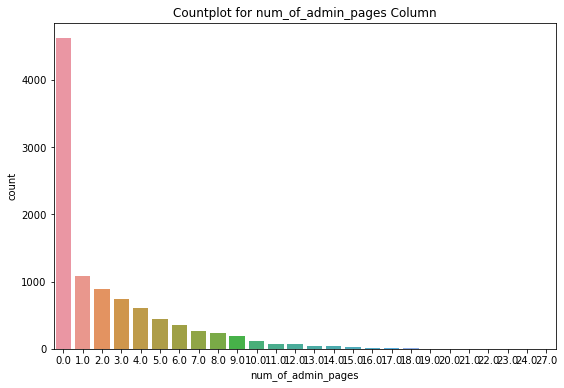

In [489]:
plt.figure(figsize = (9, 6))
Attrplot=sns.countplot(x = 'num_of_admin_pages', data = data)
plt.title("Countplot for num_of_admin_pages Column")
plt.show()

This plot shows the count of admin pages for every vector of data. We can see most e-commerce sites won't have admin pages, and the rest have more than 4. 



*filling all null values with new values by mean of the data column*

In [490]:
data['num_of_admin_pages'] = data['num_of_admin_pages'].fillna(data['num_of_admin_pages'].mean())

*Let's check this column values in order to decide what values we can fill the the missing spots*


<h4>Reviewing  all the lables with null values</h4> 

According to the results, we have decided to standardize the following columns -
<li>admin_page_duration</li>
<li>info_page_duration</li>
<li>total_duration</li>

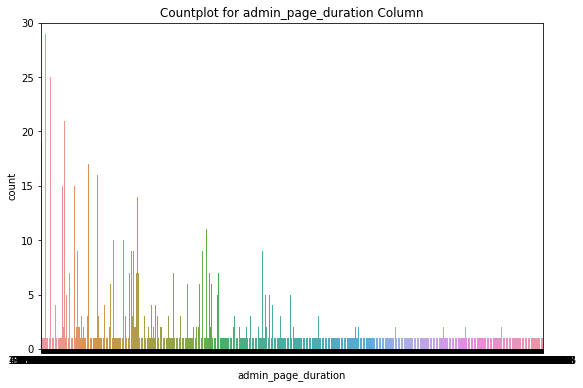

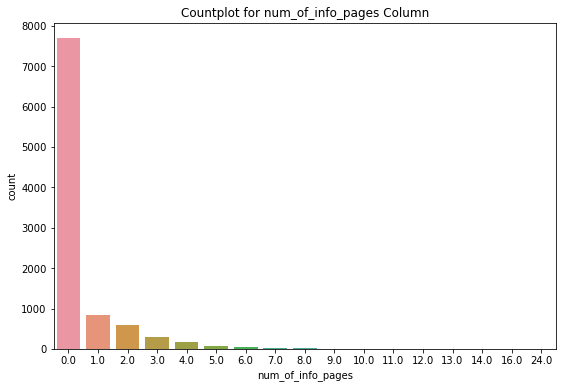

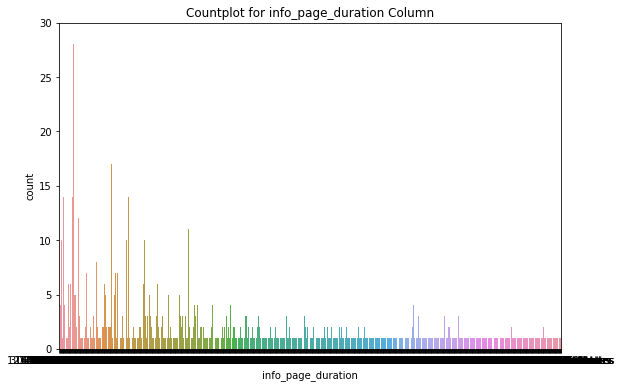

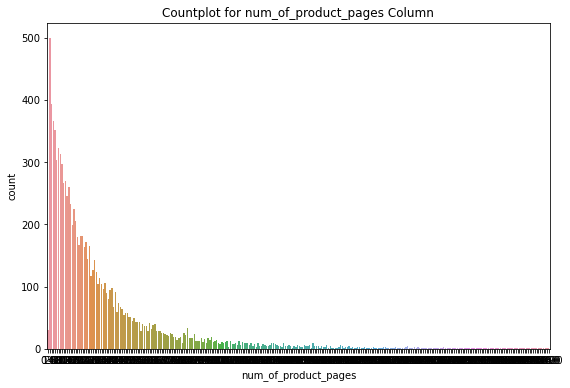

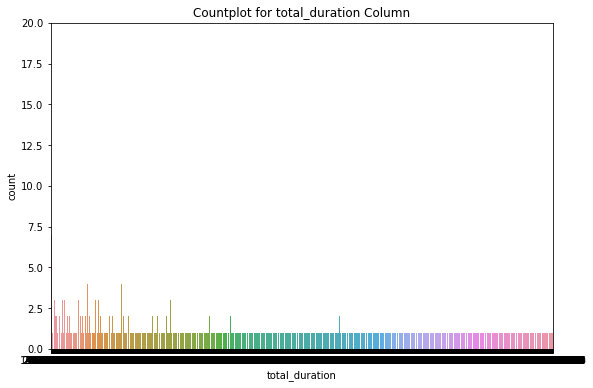

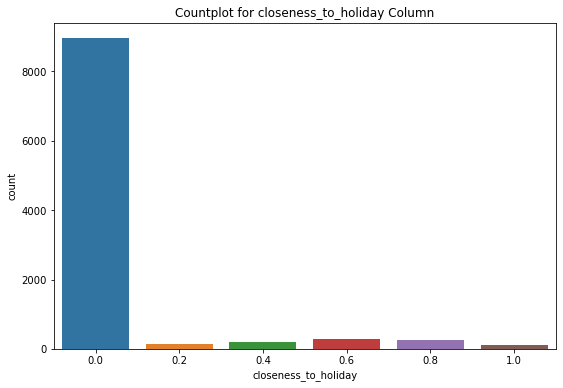

In [491]:

plt.figure(figsize = (9, 6))
sns.countplot(x = 'admin_page_duration', data = data)
plt.title("Countplot for admin_page_duration Column")
plt.ylim(0, 30)
plt.show()

plt.figure(figsize = (9, 6))
sns.countplot(x = 'num_of_info_pages', data = data)
plt.title("Countplot for num_of_info_pages Column")
plt.show()

plt.figure(figsize = (9, 6))
sns.countplot(x = 'info_page_duration', data = data)
plt.ylim(0, 30)
plt.title("Countplot for info_page_duration Column")
plt.show()

plt.figure(figsize = (9, 6))
sns.countplot(x = 'num_of_product_pages', data = data)
plt.title("Countplot for num_of_product_pages Column")
plt.show()

plt.figure(figsize = (9, 6))
sns.countplot(x = 'total_duration', data = data)
plt.ylim(0, 20)
plt.title("Countplot for total_duration Column")
plt.show()


plt.figure(figsize = (9, 6))
sns.countplot(x = 'closeness_to_holiday', data = data)
plt.title("Countplot for closeness_to_holiday Column")
plt.show()


These plots show the amount of values in each column. we can see a lot of values of 0 in closeness to holidays (we assume it means it's close to holidays when people tend to buy gifts).
In the numbers of different pages categories, we can see, the numbers of them have similar lines that go down as the number of pages goes up. We think it is because there is no infinite number of products you can create and sell.
The total duration looks very uniform,in the amount of time customers spend.
It can help us to know how to scale the data later.

<h5>We examine each feature's characteristics to determine how to fill in the blanks. We decide how to act with each feature based on information from destiny plots and preliminary exploration. We made the following assumptions about missing values:
</h5> 
<liOur first guideline was to fill out website pages by the mean because we assumed that the average could be a good indication of those with fields.</li>
<li>
The columns that related to the session duration, due to the observation, we decided to fill them out with 0 because the duration has a very wide range. We chose to not use the meaning but to relate them as 0 values as an assumption that we don’t know how long the user stays in the session.
</li>
<li>
Based on the high percentage, we should consider removing the total duration column. in addition, this column has many outliers, this is what we  .
</li>
Because categorical values like months and region are decimal, we filled with the median. For binary values, we checked the median and filed zero because we believe that filing one will affect the prediction; for example, filling'returning visitor' is safer than zero because it will not affect the prediction. Midian was used to fill the category values.

**Removing D feature**

We opted to remove D feature from our dataset as part of our pre-processing procedure.
We remove the column from our train dataset at the step below.

In [492]:
data.drop(labels=["D"], axis=1, inplace=True)

In [493]:
data_test.drop(labels=["D"], axis=1, inplace=True)

<h4>Fill out about Missing valuss</h4> 

In [494]:
def fill_NA_by_mean(data):
    col_fillna_mean = ['num_of_info_pages', 'num_of_product_pages', 'num_of_admin_pages']
    for i in col_fillna_mean:
        data[i] = data[i].fillna(data[i].mean())
        data_test[i] = data_test[i].fillna(data_test[i].mean())
        
def fill_NA_by_zero(data):    
    col_fillna_0 = ['info_page_duration','internet_browser','device','A', 'closeness_to_holiday', 'admin_page_duration', 'total_duration', 'product_page_duration','Weekend','user_type']
    for i in col_fillna_0:
        data[i] = data[i].fillna(0)
        data_test[i] = data_test[i].fillna(0)

def replace_NA_by_mean(data):
    col_repna_mean = ['BounceRates','B','ExitRates','PageValues']
    for i in col_repna_mean:
        data[i].replace( np.nan, np.mean(data[i]),inplace=True)
        data_test[i].replace( np.nan, np.mean(data_test[i]),inplace=True)
        
def fill_NA_for_Region(data):
    data['Region'].fillna((data['Region'].median()),inplace=True)#the only one so we dont need a loop
    data_test['Region'].fillna((data_test['Region'].median()),inplace=True)#the only one so we dont need a loop

    
fill_NA_by_mean(data)
fill_NA_by_zero(data)
replace_NA_by_mean(data)
fill_NA_for_Region(data)

<h4>Since the NA observations in the numeric column have been filled up, we shall pharse the text in order to convert them to float and intagre data types.</h4>

*Removing the word minutes from 'product_page_duration' column*

In [495]:
def remove_minutes(filename,df,col ):
    duration_product_no_word_mints=[]
    data_copy = pd.read_csv(filename)
    for i in range(len(data_copy[col])):
        lst_to_count_mean = []
        if type(data_copy[col][i]) is str:
            a = (data_copy[col][i].split())[0]
            lst_to_count_mean.append(float(a)) 
            df[col][i] = a
        else:
            i += 1
    arr = np.array(lst_to_count_mean)
    mean_time = np.mean(lst_to_count_mean)
    df[col].replace( np.nan, mean_time,inplace = True)

    
remove_minutes('train.csv',data,'product_page_duration')
remove_minutes('test.csv',data_test,'product_page_duration')
remove_minutes('train.csv',data,'info_page_duration')
remove_minutes('test.csv',data_test,'info_page_duration')

**Month Col count and raplacmant with numbers of months**

In [496]:
data['Month'].replace({"May":5,"Nov":11,"Dec":12,"Oct":10,"Sep":9,"Jul":7,"Aug":8,"June":6,"Feb":2,"Mar":3},inplace=True)
pltx.histogram(data,x='Month',color='purchase')

This plot shows the months and the purchase count. We can see that May and November have the most purchases. It can be explained by the holidays and new year in December.
Also, May has the highest non purchase value.Maybe people tend not to spend before vacations in the summer. And therefore summer has less traffic and data.
 



In [497]:
data['Month'].describe(include=all)

count    10454.000000
mean         7.641381
std          3.392223
min          2.000000
25%          5.000000
50%          7.000000
75%         11.000000
max         12.000000
Name: Month, dtype: float64

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


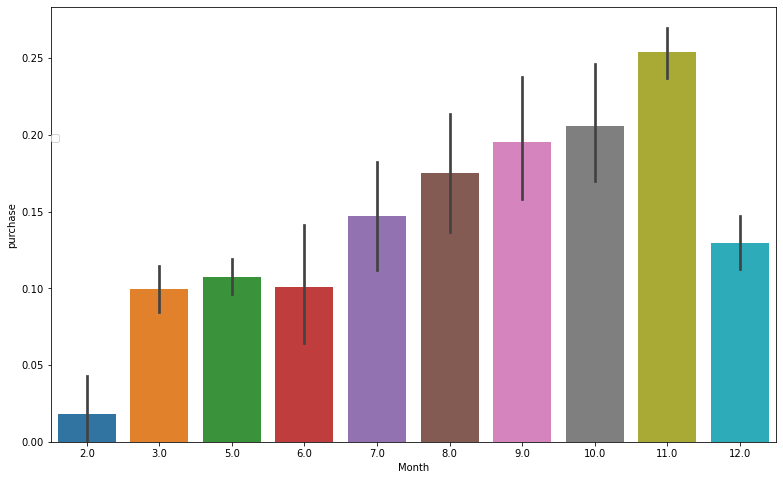

In [498]:
plt.figure(figsize=(13,8))
sns.barplot(y='purchase',x='Month',data=data)
plt.legend(loc=(0,0.69))


This plot Shows purchases in different months. We can see the beginning of autumn and December are very prolific. But we think it's better to have the data from the months and that's why we decided to turn them into dummies.



In [499]:
data['Month'].replace(nan,7,inplace=True)
data_test['Month'].replace(nan,7,inplace=True)
data=pd.get_dummies(data,columns=['Month'])
data_test=pd.get_dummies(data_test,columns=['Month'])

**Remove strings from A column**

In [500]:
def remove_str_col_A (filename,df):
    data_copy=pd.read_csv(filename)
    lst_to_md_A=[]
    for i in range(len(data_copy['A'])):
        if data_copy['A'][i] is not nan :
            a=int(data_copy['A'][i].split('_')[1])
            df['A'][i]=a
            lst_to_md_A.append(a)

        else:
            i+=1
    df['A']=df['A'].fillna(np.median(lst_to_md_A))

    
remove_str_col_A('train.csv',data)
remove_str_col_A('test.csv',data_test)
data = pd.get_dummies(data,columns=['A'])
data_test = pd.get_dummies(data_test,columns=['A'])

In [501]:
#for pipeline 
def get_dum(d,col):
    d = pd.get_dummies(d,columns=[col])
    return d


**Remove strings from C column**

In [502]:
def remove_str_col_C(filename,df):
    data_copy=pd.read_csv(filename)
    for i in range(len(data_copy['C'])):
        if df['C'][i] is not nan and data_copy['C'][i]!="log_100":
            a=int(data_copy['C'][i].split('g')[1])
            df['C'][i]=a

        elif data_copy['C'][i]=="log_100":
            a=int(data_copy['C'][i].split('_')[1])
            df['C'][i]=a

        else:
            i+=1
    median_C=np.median(data['C'])
    df['C'].replace(np.nan,median_C,inplace=True)
remove_str_col_C('train.csv',data)
remove_str_col_C('test.csv',data_test)

In [503]:
data = pd.get_dummies(data,columns=['C'])
data_test = pd.get_dummies(data_test,columns=['C'])

In [504]:
data_nu= data.isnull().astype(int)
pltx.imshow(data_nu,color_continuous_scale='Blues',title="After removing nulls-no nulls")

In [505]:
data_nu= data_test.isnull().astype(int)
pltx.imshow(data_nu,color_continuous_scale='Blues',title="After removing nulls-no nulls")

As we can see, there are no Null values in our train data set and test data set any more, so we can be sure there wont be errors in models.

<h2>Outliers<h2/>
<h5>visualizing our numerical columns to get a high-level overview of our feature's outliers<h5/>

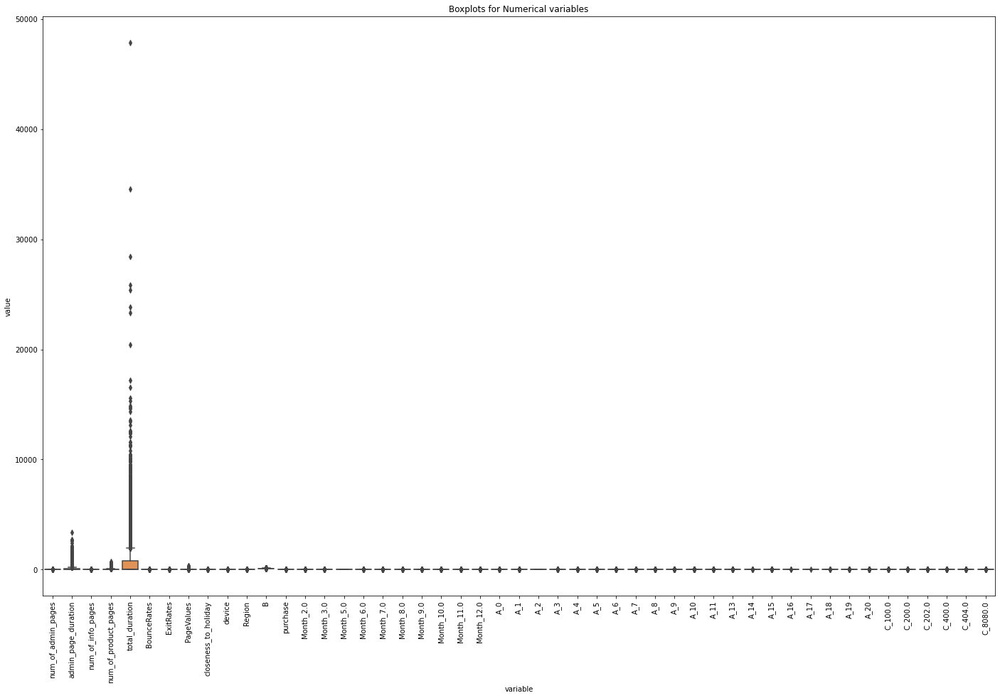

In [506]:
updated_numeric_cols = list(data.select_dtypes(include=[np.number]).columns)
newnumeric=data[updated_numeric_cols]
newnumericmelt=newnumeric.melt()
newnumericmelt['value'].astype(str).astype(float)

plt.figure(figsize=(24,15))
plt.title("Boxplots for Numerical variables")
bp=sns.boxplot(x='variable',y='value',data=newnumericmelt)
bp.set_xticklabels(bp.get_xticklabels(),rotation=90)
plt.show()

We plotted outliers for all of the columns, and based on a high-level overview, we discovered numerous features with outliers. As a result, we'll look at those columns more closely and deal with their outliers.
Total duration has the highest number of outliers, and admin pages some.
The next step is to treat outliers.
 



In [507]:
from numpy import nan
vector = data['total_duration']
time_vec= []
for i in range(len(data['total_duration'])):
    if data['purchase'][i] == 0: 
        #print(data['total_duration'][i])
        time_vec.append(data['total_duration'][i])

    else:
        i+=1
time_vec=np.array(time_vec)
new_list = [item for item in time_vec if not(math.isnan(item)) == True]
#print(new_list)
mean_numeric_duration_time = np.mean(new_list)
mean_numeric_duration_time
for i in range(len(data['total_duration'])):
    if math.isnan(data['total_duration'][i]):
        data['total_duration'][i] = mean_numeric_duration_time
pltx.scatter(data,x='total_duration',color='purchase',title="Total duration values dispersing by purchase")


The plot shows the  scatter of the points and the color of the purchase. We can see , the values that look like outliers are more frequent not to buy,although there are some purchases.
So we can eliminate outliers without affecting the prediction a lot.


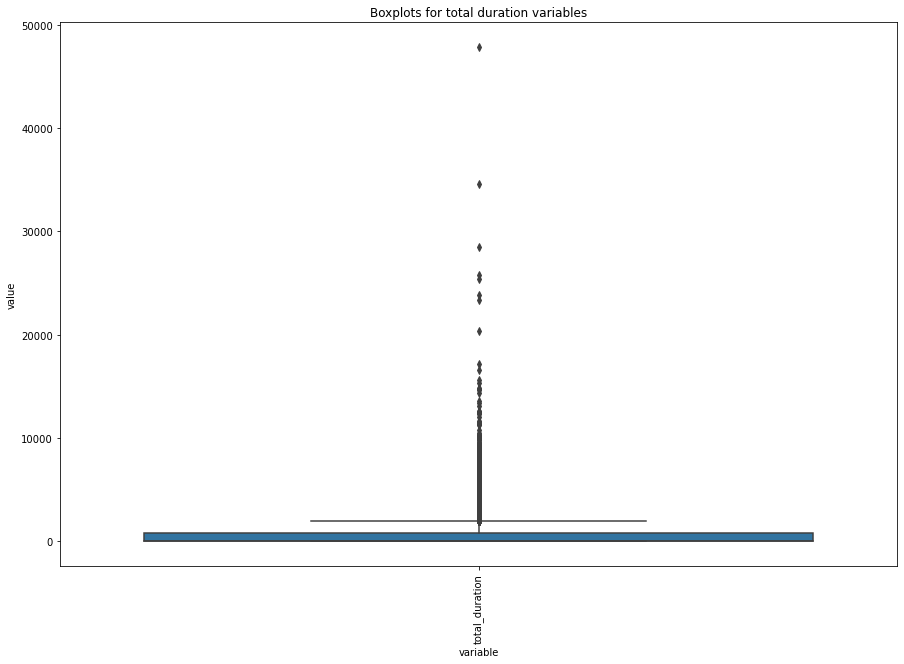

In [508]:
total_duration_outliers=data[[ 'total_duration']]
total_duration_outliers_melt=total_duration_outliers.melt()
total_duration_outliers_melt['value'].astype(str).astype(float)

plt.figure(figsize=(15,10))
plt.title("Boxplots for total duration variables")
bp=sns.boxplot(x='variable',y='value',data=total_duration_outliers_melt)
bp.set_xticklabels(bp.get_xticklabels(),rotation=90)
plt.show()

Observation: 
In the total duration column, there are a few outliers. Our total duration measures the amount of time the user was connected to the session; we can imagine that some people accidentally leave their connection open or leave their computer open, resulting in very high values being misinterpreted as fault values.
We assumed that anything more than 6 hours would be considered a fault value, and that the median would be used instead.


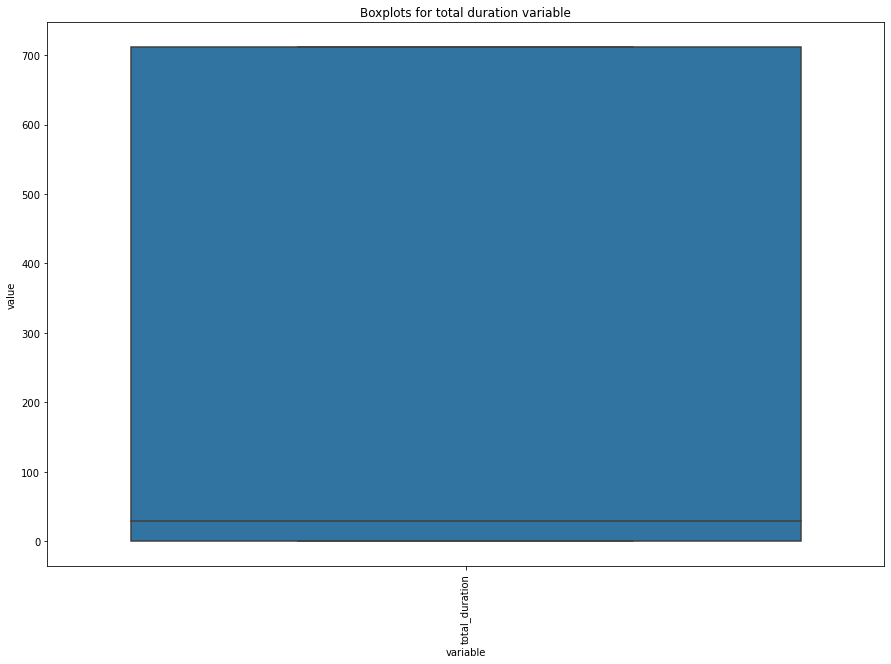

In [509]:
data["total_duration"] = np.where(data["total_duration"] >6*60, data['total_duration'].mean(),data['total_duration'])
total_duration_after_calc=data[['total_duration']].melt()
total_duration_after_calc['value'].astype(str).astype(float)

plt.figure(figsize=(15,10))
plt.title("Boxplots for total duration variable")
bp=sns.boxplot(x='variable',y='value',data=total_duration_after_calc)
bp.set_xticklabels(bp.get_xticklabels(),rotation=90)
plt.show()

This plot shows total duration values after treating outliers.
It is important because outliers can affect the prediction and make it less accurate because they don't show the average data point.
 
 
 



In [510]:
from numpy import nan
vector = data['total_duration']
time_vec= []
for i in range(len(data['total_duration'])):
    if data['purchase'][i] == 0: 
        #print(data['total_duration'][i])
        time_vec.append(data['total_duration'][i])

    else:
        i+=1
time_vec=np.array(time_vec)
new_list = [item for item in time_vec if not(math.isnan(item)) == True]
mean_numeric_duration_time = np.mean(new_list)
mean_numeric_duration_time
for i in range(len(data['total_duration'])):
    if math.isnan(data['total_duration'][i]):
        data['total_duration'][i] = mean_numeric_duration_time
pltx.scatter(data,x='total_duration',color='purchase')


This plot shows the scatter of the points after treating outliers in total duration. We can see more points of not purchase than purchase, but they are scattered across all times 


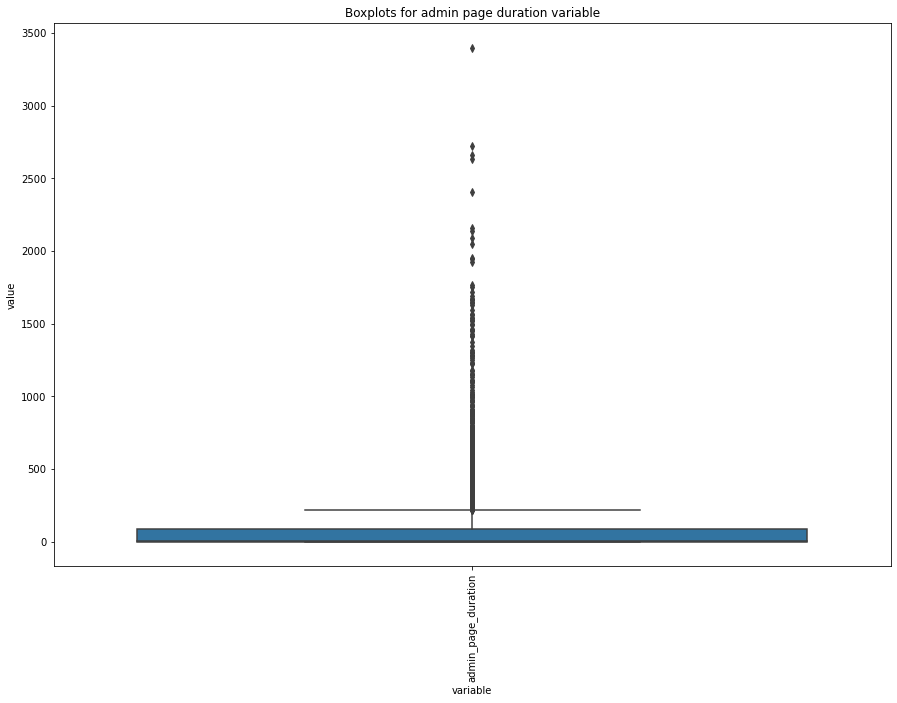

In [511]:
admin_page_duration_outliers=data[[ 'admin_page_duration']]
admin_page_duration_outliers_melt=admin_page_duration_outliers.melt()
admin_page_duration_outliers_melt['value'].astype(str).astype(float)

plt.figure(figsize=(15,10))
plt.title("Boxplots for admin page duration variable")
bp=sns.boxplot(x='variable',y='value',data=admin_page_duration_outliers_melt)
bp.set_xticklabels(bp.get_xticklabels(),rotation=90)
plt.show()

This plot is the box plot of outliers in admin pages, we need to treat them in order to keep our data accurate .


In [512]:
def admin_page_ouliers(d):
    d["admin_page_duration"] = np.where(d["admin_page_duration"] >6*60, d['admin_page_duration'].mean(),d['admin_page_duration'])
    admin_page_duration_after_calc=d[['admin_page_duration']].melt()
    return admin_page_duration_after_calc['value'].astype(str).astype(float)

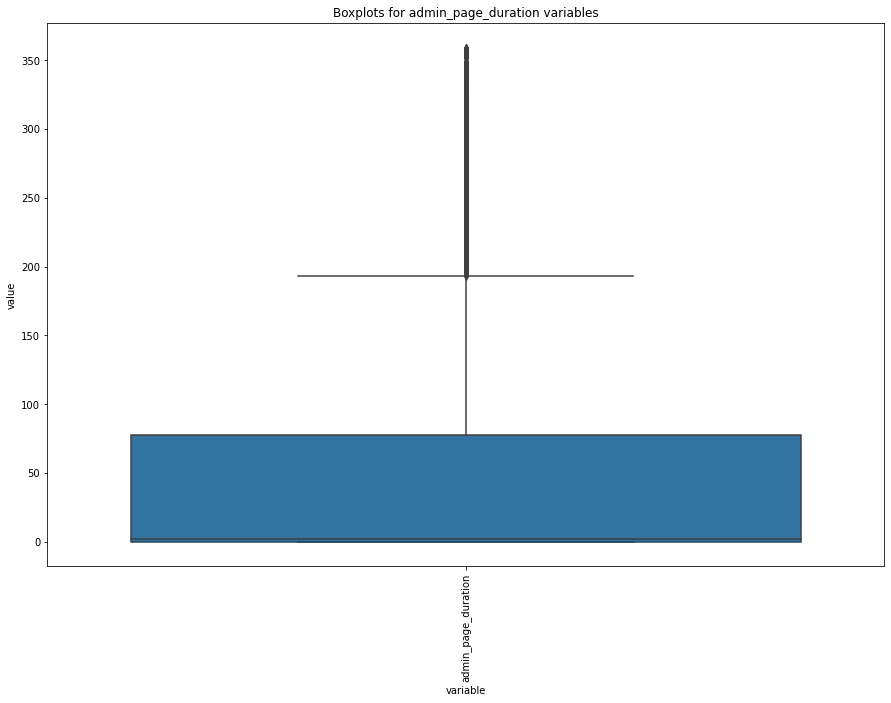

In [513]:
data["admin_page_duration"] = np.where(data["admin_page_duration"] >6*60, data['admin_page_duration'].mean(),data['admin_page_duration'])
admin_page_duration_after_calc=data[['admin_page_duration']].melt()
admin_page_duration_after_calc['value'].astype(str).astype(float)

plt.figure(figsize=(15,10))
plt.title("Boxplots for admin_page_duration variables")
bp=sns.boxplot(x='variable',y='value',data=admin_page_duration_after_calc)
bp.set_xticklabels(bp.get_xticklabels(),rotation=90)
plt.show()

This plot is after the outliers treatment. 

<h3>Imbalance Analysis<h3/>

*We would like to ensure that the data is balanced and that we have a sufficient number of purchasers.*

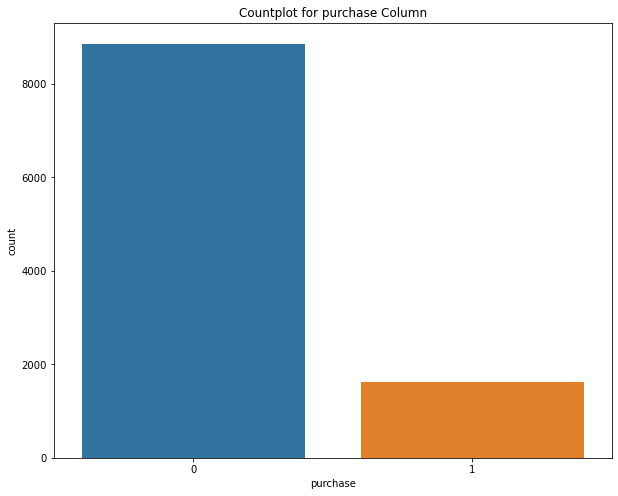

In [514]:
plt.figure(figsize = (10, 8))
Attrplot=sns.countplot(x = 'purchase', data = data)
plt.title("Countplot for purchase Column")
plt.show()

*We don't have any information regarding imbalances. Users who purchased in the market account for 15% of the rows*

<h3>Categorial Analysis<h3/>

*view the number of unique values each column*


In [515]:
features=data.columns
for i in features:
    uniqueValues=data[i].nunique()
    print(i,uniqueValues)
    
data.dtypes

num_of_admin_pages 27
admin_page_duration 2401
num_of_info_pages 18
info_page_duration 1090
num_of_product_pages 293
product_page_duration 7804
total_duration 1127
BounceRates 1646
ExitRates 4149
PageValues 2297
closeness_to_holiday 6
device 9
internet_browser 127
Region 9
user_type 4
Weekend 2
B 10457
purchase 2
Month_2.0 2
Month_3.0 2
Month_5.0 2
Month_6.0 2
Month_7.0 2
Month_8.0 2
Month_9.0 2
Month_10.0 2
Month_11.0 2
Month_12.0 2
A_0 2
A_1 2
A_2 2
A_3 2
A_4 2
A_5 2
A_6 2
A_7 2
A_8 2
A_9 2
A_10 2
A_11 2
A_13 2
A_14 2
A_15 2
A_16 2
A_17 2
A_18 2
A_19 2
A_20 2
C_100.0 2
C_200.0 2
C_202.0 2
C_400.0 2
C_404.0 2
C_8080.0 2


num_of_admin_pages       float64
admin_page_duration      float64
num_of_info_pages        float64
info_page_duration        object
num_of_product_pages     float64
product_page_duration     object
total_duration           float64
BounceRates              float64
ExitRates                float64
PageValues               float64
closeness_to_holiday     float64
device                   float64
internet_browser          object
Region                   float64
user_type                 object
Weekend                   object
B                        float64
purchase                   int64
Month_2.0                  uint8
Month_3.0                  uint8
Month_5.0                  uint8
Month_6.0                  uint8
Month_7.0                  uint8
Month_8.0                  uint8
Month_9.0                  uint8
Month_10.0                 uint8
Month_11.0                 uint8
Month_12.0                 uint8
A_0                        uint8
A_1                        uint8
A_2       

<h3>Our categorial colums are:</h3>
<br>

<li>info_page_duration - should be converted to float</li>
<li>product_page_duration - should be converted to float</li>
<li>Month</li>
<li>internet_browser</li>
<li>user_type</li>
<li>Weekend</li>
<li>A</li>
<li>C</li>

<h4>Replacing Categorial features</h4>

In [516]:
data.Weekend.replace({False: 0, True: 1}, inplace=True)
data['Weekend'].replace(nan,0,inplace=True)
data_test.Weekend.replace({False: 0, True: 1}, inplace=True)
data_test['Weekend'].replace(nan,0,inplace=True)

In [517]:
data['user_type'].replace({"Returning_Visitor":1,"New_Visitor":0,"Other":1},inplace=True)
data['user_type'].replace(nan,0,inplace=True)
data_test['user_type'].replace({"Returning_Visitor":1,"New_Visitor":0,"Other":1},inplace=True)
data_test['user_type'].replace(nan,0,inplace=True)


<AxesSubplot:title={'center':'user_type'}>

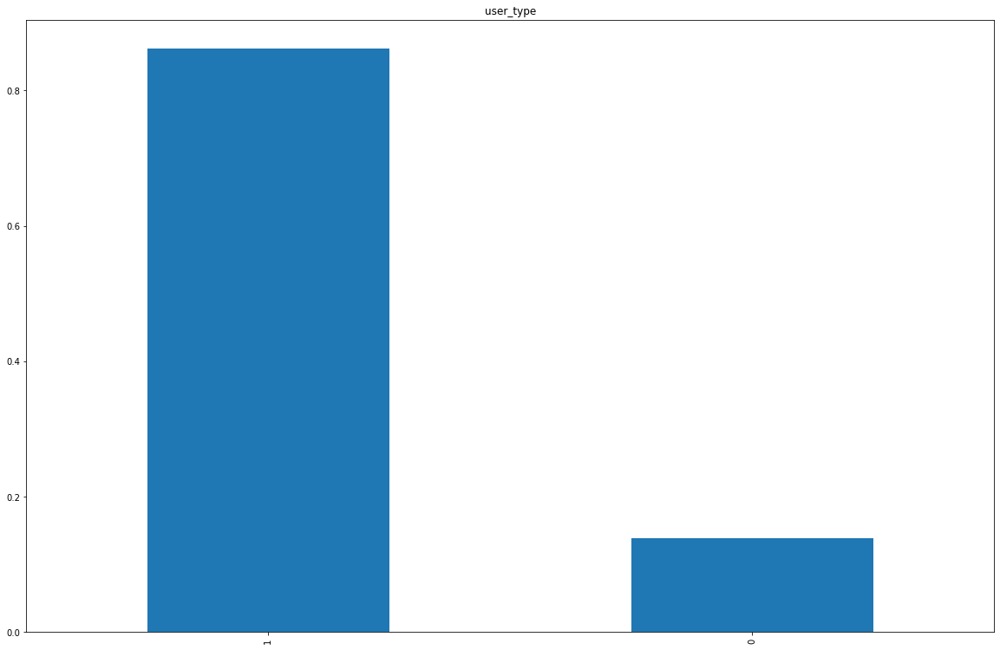

In [518]:
data['user_type'].value_counts(normalize=True).plot.bar(figsize=(20,13), title= 'user_type')

This plot shows value count of user type, we turned this colunm itno binary and filled nan with zero. 
This graph helps us to see that after filling the data with 0 we still have mostly 1s.

In [519]:
#for pipeline
def weekend(d):
    d.Weekend.replace({False: 0, True: 1}, inplace=True)
    d['Weekend'].replace(nan,0,inplace=True)

    pass
    
    

In [520]:
#for pipeline
def user(d):
    d['user_type'].replace({"Returning_Visitor":1,"New_Visitor":0,"Other":1},inplace=True)
    d['user_type'].replace(nan,0,inplace=True)
    pass

The majority of users, more than 80%, are returning visitors, which means they have visited the website previously.

In [521]:
def isfloat(num):
    try:
        float(num)
        return True
    except ValueError:
        return False

def browser_to_num(df):    
    for i in range(len(df['internet_browser'])):
        if df['internet_browser'][i] is not None and isfloat(df['internet_browser'][i]) is False:
            word = df['internet_browser'][i].split('_')[0]
            if word == 'chrome':
                df['internet_browser'][i] = 1
            else:
                df['internet_browser'][i] = 0
        else:
            i+=1

    browser_mid=np.median(df['internet_browser'])
    #print(browser_mid)
    for i in range(len(df['internet_browser'])):
        if math.isnan(df['internet_browser'][i]):
            df['internet_browser'][i] = browser_mid
   
    pass
browser_to_num(data)
browser_to_num(data_test)

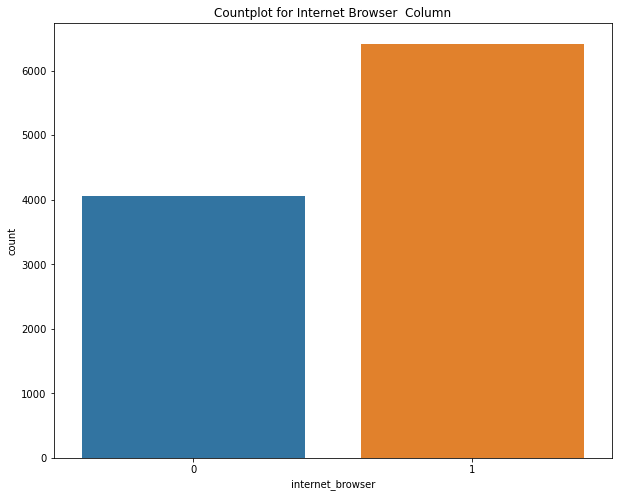

In [522]:
plt.figure(figsize = (10, 8))
Attrplot=sns.countplot(x = 'internet_browser', data = data)
plt.title("Countplot for Internet Browser  Column")
plt.show()

we segment our categorical user browsers for 2 options- 
<li>0 - Non-Chrome </li>
<li>1 - Chrome </li>


<h5> The majority of people surf on the e-commerce website use Google Chrome.</h5>

<h5>Removing Total duration columns due to a very high Null values( more then 45% ) , as well as outliers that effects the relability of this indicators</h5>

In [523]:
data.get('device')

0        1.0
1        4.0
2        3.0
3        2.0
4        2.0
        ... 
10474    4.0
10475    3.0
10476    3.0
10477    2.0
10478    3.0
Name: device, Length: 10479, dtype: float64

<h3>Additional Indicators</h3>
<br>
We wanted to look at the train set more closely.
Walking through the data, segmented by column value, to see how many individuals buy it and how many dont

<AxesSubplot:xlabel='Region', ylabel='count'>

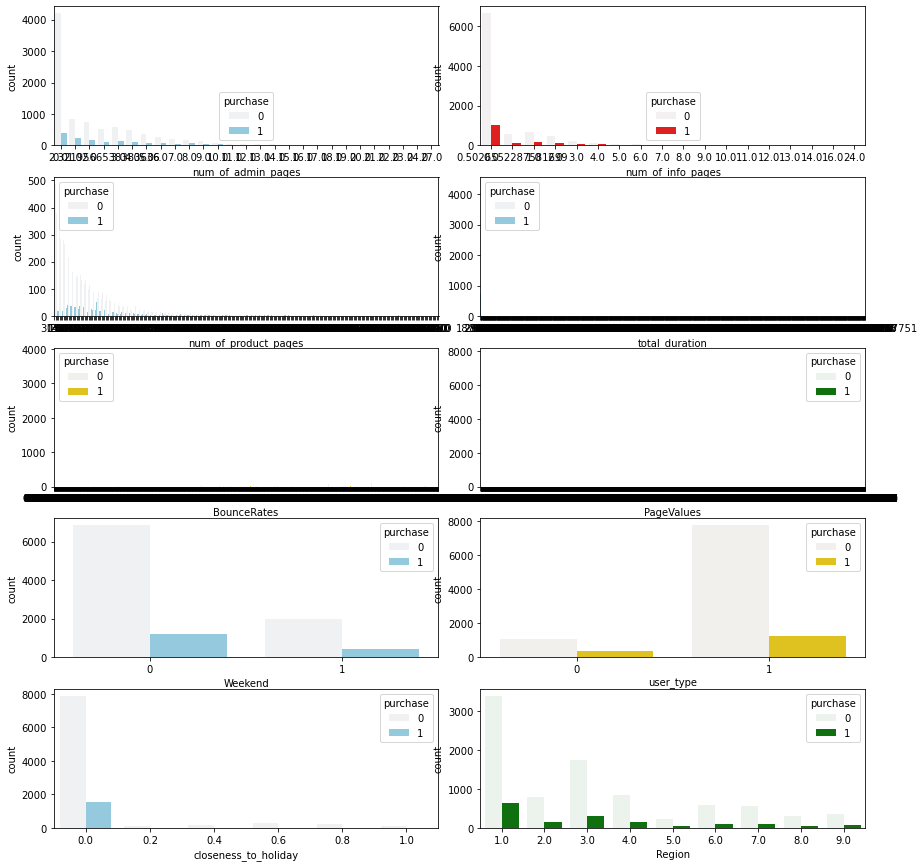

In [524]:
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(12, 12))
fig.tight_layout()

sns.countplot(x='num_of_admin_pages',hue='purchase' , data=data, color="skyblue", ax=axs[0, 0])
sns.countplot(x='num_of_info_pages',hue='purchase' , data=data, color="red", ax=axs[0, 1])
sns.countplot(x='num_of_product_pages',hue='purchase' , data=data, color="skyblue", ax=axs[1, 0])
sns.countplot(x='total_duration',hue='purchase' , data=data, color="skyblue", ax=axs[1, 1])
sns.countplot(x='BounceRates',hue='purchase' , data=data, color="gold", ax=axs[2, 0])
sns.countplot(x='PageValues',hue='purchase' , data=data, color="green", ax=axs[2, 1])
sns.countplot(x='Weekend',hue='purchase' , data=data, color="skyblue", ax=axs[3, 0])
sns.countplot(x='user_type',hue='purchase' , data=data, color="gold", ax=axs[3, 1])
sns.countplot(x="closeness_to_holiday",hue='purchase' , data=data, color="skyblue", ax=axs[4, 0])
sns.countplot(x='Region',hue='purchase' , data=data, color="green", ax=axs[4, 1])


This plot shows us different value counts in columns , and we can see if there was a purchase or not.
It helps us to make connections between column value and how many purchases were



<AxesSubplot:xlabel='BounceRates', ylabel='ExitRates'>

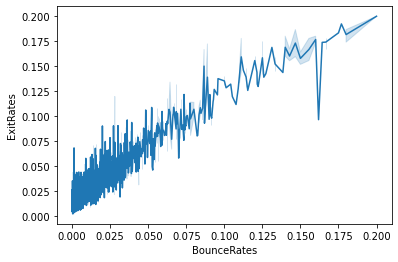

In [525]:
sns.lineplot(x='BounceRates',y='ExitRates',data=data)

This plot support our desition to do not remove / or unitife this feature together.Base on the smaller vluaes, the left-button part of the system- the correalation seems to not totali approprariate,
in comparasiton to the right-top side that looks more correlative.
Hence we would want to save both features

<AxesSubplot:xlabel='purchase', ylabel='PageValues'>

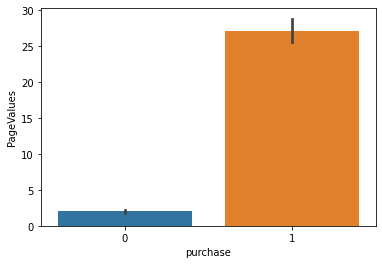

In [526]:
sns.barplot(x='purchase', y='PageValues', data=data)

We saw in the correlation matrix that pageValues has the highest correlation to purchase.
Here there almost all observations are 1, so it is an important column form our prediction

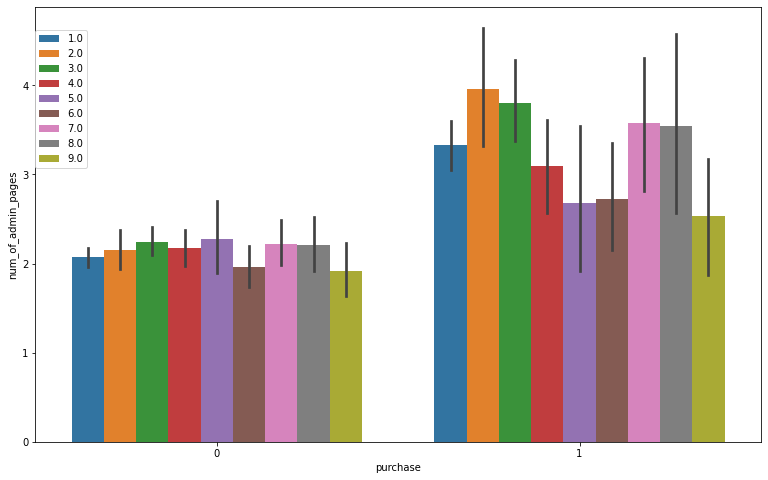

In [527]:
plt.figure(figsize=(13,8))
sns.barplot(y='num_of_admin_pages',x='purchase',data=data,hue='Region')
plt.legend(loc=(0,0.63))

During the exploration and preparation, we believed that the 'Total durtion' column would be unreliable and irrelevant- 45 percent of Null, and a very broad range of values with outliers. of We decide to eliminate the total duration column based on the findings from the previous section.

In [528]:
data.drop(labels=["total_duration"], axis=1, inplace=True)

In [529]:
data.columns

Index(['num_of_admin_pages', 'admin_page_duration', 'num_of_info_pages',
       'info_page_duration', 'num_of_product_pages', 'product_page_duration',
       'BounceRates', 'ExitRates', 'PageValues', 'closeness_to_holiday',
       'device', 'internet_browser', 'Region', 'user_type', 'Weekend', 'B',
       'purchase', 'Month_2.0', 'Month_3.0', 'Month_5.0', 'Month_6.0',
       'Month_7.0', 'Month_8.0', 'Month_9.0', 'Month_10.0', 'Month_11.0',
       'Month_12.0', 'A_0', 'A_1', 'A_2', 'A_3', 'A_4', 'A_5', 'A_6', 'A_7',
       'A_8', 'A_9', 'A_10', 'A_11', 'A_13', 'A_14', 'A_15', 'A_16', 'A_17',
       'A_18', 'A_19', 'A_20', 'C_100.0', 'C_200.0', 'C_202.0', 'C_400.0',
       'C_404.0', 'C_8080.0'],
      dtype='object')

In [530]:
data_test.columns

Index(['num_of_admin_pages', 'admin_page_duration', 'num_of_info_pages',
       'info_page_duration', 'num_of_product_pages', 'product_page_duration',
       'total_duration', 'BounceRates', 'ExitRates', 'PageValues',
       'closeness_to_holiday', 'device', 'internet_browser', 'Region',
       'user_type', 'Weekend', 'B', 'Month_7', 'Month_Aug', 'Month_Dec',
       'Month_Feb', 'Month_Jul', 'Month_June', 'Month_Mar', 'Month_May',
       'Month_Nov', 'Month_Oct', 'Month_Sep', 'A_0', 'A_1', 'A_2', 'A_3',
       'A_4', 'A_5', 'A_6', 'A_7', 'A_8', 'A_9', 'A_10', 'A_11', 'A_12',
       'A_13', 'A_14', 'A_15', 'A_18', 'A_19', 'A_20', 'C_100.0', 'C_200.0',
       'C_202.0', 'C_400.0', 'C_404.0', 'C_8080.0'],
      dtype='object')

*We found that the test set has dummuy vlue A_12 that train does not have, and columns A_16 ,A_17 in the train that the test are not part of test.So inorder to have the same dimansions in the prosses, we removed them in the function in the pipeline and in this part in the train data.*

In [531]:
data.drop('A_16',inplace=True,axis=1)
data.drop('A_17',inplace=True,axis=1)

<h2>Standardization</h2>

Standardization: All the variables should be on the same scale before applying, we chose to use standatd scler,</br> it fits our data better becuse the type of float values.


In [532]:
data.drop('purchase',inplace = True,axis =1)



In [533]:
X.shape


(10479, 22)

In [534]:
X = data.values

In [535]:
data.columns

Index(['num_of_admin_pages', 'admin_page_duration', 'num_of_info_pages',
       'info_page_duration', 'num_of_product_pages', 'product_page_duration',
       'BounceRates', 'ExitRates', 'PageValues', 'closeness_to_holiday',
       'device', 'internet_browser', 'Region', 'user_type', 'Weekend', 'B',
       'Month_2.0', 'Month_3.0', 'Month_5.0', 'Month_6.0', 'Month_7.0',
       'Month_8.0', 'Month_9.0', 'Month_10.0', 'Month_11.0', 'Month_12.0',
       'A_0', 'A_1', 'A_2', 'A_3', 'A_4', 'A_5', 'A_6', 'A_7', 'A_8', 'A_9',
       'A_10', 'A_11', 'A_13', 'A_14', 'A_15', 'A_18', 'A_19', 'A_20',
       'C_100.0', 'C_200.0', 'C_202.0', 'C_400.0', 'C_404.0', 'C_8080.0'],
      dtype='object')

In [536]:
X.shape

(10479, 50)

In [537]:
stc = StandardScaler()
X=stc.fit_transform(X)

In [538]:
random_state = 42
test_size = 0.25

In [539]:
#for pipeline
def split_tr_vl(XX):
    X_train, X_validation, y_train, y_validation = train_test_split(XX,y, test_size=test_size, random_state=random_state)
    return X_train, X_validation, y_train, y_validation

In [540]:
X_train, X_validation, y_train, y_validation = train_test_split(X,y, test_size=test_size, random_state=random_state)

In [541]:
X_train.shape

(7859, 50)

In [542]:
X_validation.shape

(2620, 50)

<h2>Dimensionality Reduction</h2>

**Dimensionality reduction refers to techniques that reduce the number of input variables in a dataset**

When there are too many input variables, the performance of machine learning algorithms might suffer.


The columns of data may be thought of as dimensions on an n-dimensional feature space, while the rows of data can be thought of as points in that space. This is a good way to understand a dataset geometrically.


<h5>Why we chose pca over  feature selection forward selection ?</h5>
We tested the option to use feature selection, but decided not to include feature selection. We are not experts in the e-comerce domain and rather have more data values with 
,than dimensions and features after feature selection. 

We chose PCA because of the bias-variance tradeoff, our exploration indicates alot of variance and PCA reduces variance.


In [543]:

probabilities=[0.5, 0.6, 0.6, 0.7, 0.75, 0.8, 0.85,0.88,0.9,0.93,0.95,0.97,0.98,0.99001,0.99901,0.9999901]
num_of_features = np.ndarray(shape = (2,len(probabilities)),dtype = float)
for i in range(len(probabilities)) :
    copytrain=X_train.copy()
    pca = PCA(probabilities[i])
    pca.fit(copytrain,y_train)
    num_of_features[0,i] = len(pca.components_)
    num_of_features[1,i] = probabilities[i]
pltx.line(num_of_features,x = num_of_features[0,:],y = num_of_features[1,:],title = "PCA - Number Of Features For Diffrent Expleind Trashold ",markers=True)


This plot shows us how many dimensions are needed to get to different summed variance thresholds.</br>
We need this graph because we want to get 95% explained variance. We can see that it is at 41


In [544]:
#pipeline
def pca_func():
    pca = PCA(n_components=41)
    return pca.fit_transform(X)

We can deduce that 41 features achieve a 95 percent correct prediction rate.

In [545]:
pca = PCA(n_components=41)
Xpca = pca.fit_transform(X)
Xpca.shape

(10479, 41)

In [546]:
X_train.shape

(7859, 50)

In [547]:
pca.components_.shape

(41, 50)

In [548]:
data.columns.shape

(50,)

In [549]:
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)}

fig = px.scatter_matrix(
    Xpca,
    labels=labels,
    dimensions=range(6),
)
fig.update_traces(diagonal_visible=False)
fig.show()

This graph shows how much of the overall variation each major component explains. We discovered that PCA2 and PCA1 had greater correltaive explained variance than the other pairings.</br>
We did the plot for 6 in order to observe better the effect of pca on out data

In [550]:
print(pca.components_)

[[ 0.36494588  0.31882703  0.30671359 ...  0.00870687 -0.00459649
  -0.01323902]
 [ 0.09316616  0.01351543  0.22320583 ...  0.00184353  0.00084726
  -0.00349715]
 [-0.02569526 -0.06933762  0.11189096 ... -0.03555334  0.00879471
  -0.01175325]
 ...
 [-0.06074454  0.00756675  0.15303259 ... -0.01438971  0.03061958
  -0.01382343]
 [ 0.02219277  0.0128121  -0.03157228 ... -0.00600295  0.02366886
   0.00251217]
 [ 0.0157521   0.00989397 -0.01005831 ... -0.04028568 -0.00417427
   0.0078867 ]]


In [551]:
explained_variance = pca.explained_variance_ratio_
fig = pltx.line(explained_variance,title="PCA Feature Importance")
fig.show()

This plot shows the individual variance of our components,how much variance each component brings on their on≈e to the pca model.
We need that because feature importance in pca is the explained variance ratio


original shape:    (7859, 50)
transformed shape: (7859, 41)


Text(0.5, 1.0, 'Xtrain before and after pca')

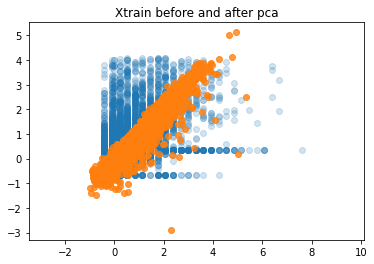

In [552]:
X_pca = pca.transform(X_train)
print("original shape:   ", X_train.shape)
print("transformed shape:", X_pca.shape)
X_new = pca.inverse_transform(X_pca)
plt.scatter(X[:, 0], X[:, 1], alpha=0.2)
plt.scatter(X_new[:, 0], X_new[:, 1], alpha=0.8)
plt.axis('equal')


plt.title('Xtrain before and after pca')

We can see the dimensionality reduction, the blue is xtrein before and the orange is the dimantions after the dimensionality reduction.
It looks like it can make the prediction better.

In [553]:
X_train ,X_validation ,y_train, y_validation = train_test_split(Xpca,y,test_size = test_size, random_state= random_state, shuffle=True)

<h2>Data Selection and Model Fitting</h2>

In [554]:
X_train = X_train.astype('float64')
y_train = y_train.astype('float64')
X_validation = X_validation.astype('float64')
y_validation = y_validation.astype('float64')

In [555]:
def plot_conf_matrix_func( model,model_name_str,xval ,yval,acu_score):

    # plots confusion matrix

    plot_confusion_matrix(model , xval.astype('float64') , yval.astype('float64') , cmap=plt.cm.Blues)
    plt.title('Confusion Matrix Train '+model_name_str)
    print(acu_score,'accuracy')
    

In [556]:
def plot_roc_curve_func(yval , yscore , model_name_str):
    
    #plots auc roc curve 

    fpr, tpr, thresholds = roc_curve(yval, yscore)
    fig = pltx.area(
        x=fpr, y=tpr,
        title=model_name_str+ f' ROC Curve (AUC={auc(fpr, tpr):.4f})',
        labels=dict(x='False Positive Rate', y='True Positive Rate'),
        width=700, height=500
    )
    fig.add_shape(
        type='line',line=dict(dash='dash'),
        x0=0, x1=1, y0=0, y1=1
    )

    fig.update_yaxes(scaleanchor="x", scaleratio=1)
    fig.update_xaxes(constrain='domain')
    fig.show()
    


In [557]:
def Kfolds_best_n(model,XX,yy,xvl,yvl):

    # search best k folds value by accuracy
    
    KF_d = {}
    for i in range(5,20,2):
        index = str(i)
        kfd = KFold(n_splits=i,shuffle=True,random_state=42)
        kfd.split(XX,yy)
        model.fit(XX,yy)
        pred = model.predict(xvl)
        acc = accuracy_score(yvl,pred)
        KF_d [index]=acc
        best_n = max(KF_d, key=KF_d.get)
        best_Acu = KF_d.get(best_n)
    return best_n,best_Acu

In [558]:
def cross_validaion_best_cv(model , XX, yy ):

    #search best cross val n and accuracy
    
    Val_d = {}
    for i in range(5,20,2):
        index = str(i)
        val_Scores = cross_val_score (model,XX,yy,cv=i)
        Val_d [index]=val_Scores.mean()
        best_n = max(Val_d, key=Val_d.get)
        best_Acu = Val_d.get(best_n)
    return best_n,best_Acu


<h3>Logistic Regression</h3>

In [559]:
y_validation.shape

(2620,)

In [560]:
param = {}
param['C']=[0.1,1.0,2.0,10.0,100.0,1000.0]
param['random_state']=[1,10,42,100,200,400]
param['solver']=['newton-cg','lbfgs','liblinear','sag','saga']

best_p_lr = GridSearchCV(LogisticRegression(),param_grid=param)
best_p_lr.fit(X_train,y_train)

GridSearchCV(estimator=LogisticRegression(),
             param_grid={'C': [0.1, 1.0, 2.0, 10.0, 100.0, 1000.0],
                         'random_state': [1, 10, 42, 100, 200, 400],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga']})

In [561]:
best_p_lr.best_params_

{'C': 2.0, 'random_state': 1, 'solver': 'newton-cg'}

*We added n_jobs= -1, because of the test size, in order to avoide warning*

In [562]:
logistic_reg = LogisticRegression(**best_p_lr.best_params_,n_jobs=-1)
logistic_reg.fit(X_train,y_train)
y_pred_val= logistic_reg.predict(X_validation.astype('float64'))
y_scoure_logreg = logistic_reg.predict_proba(X_validation)[:,1]
logistic_acu = accuracy_score(y_validation.astype('float64'),y_pred_val.astype('float64'))
logistic_acu

0.8870229007633588

In [563]:
#This value is used in a plot in part 4
mse_lr = mean_squared_error(y_validation,y_pred_val)

In [564]:
cross_validaion_best_cv(logistic_reg,X_train,y_train)

('5', 0.8834453347327434)

In [565]:
Kfolds_best_n(logistic_reg,X_train,y_train,X_validation,y_validation)

('5', 0.8870229007633588)

0.8870229007633588 accuracy


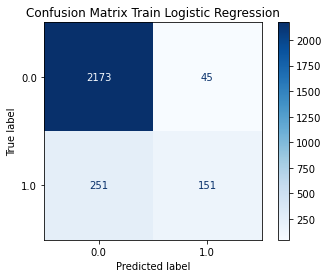

In [566]:
plot_conf_matrix_func(logistic_reg,"Logistic Regression",X_validation,y_validation,logistic_acu)

Plot of confusion matrix for logistic regression, we need that to see the number of true positives and true negatives , this is one of the ways to see how many values were predicted right
 


In [567]:
plot_roc_curve_func(y_validation,y_scoure_logreg,"Logistic Regression")

Auc is important, 0.88 times the model predicted write the label.
This shows high result and the ability to classify.

In [568]:
c = classification_report(y_validation,y_pred_val,output_dict=True)
c['1.0']

{'precision': 0.7704081632653061,
 'recall': 0.3756218905472637,
 'f1-score': 0.5050167224080268,
 'support': 402}

In [569]:
logistic_reg.coef_.shape[1]

41

In [570]:
logistic_reg.coef_.shape[1]

41

In [571]:
pltx.bar(x=range(0,logistic_reg.coef_.shape[1]),y=logistic_reg.coef_[0,:],title='Logistic Regression Coefficient -Feature Importance')

 For logistic regression, feature importance is the coefficients. We want to check how removing columns with low coefficients will affect our prediction, or how if the high coefficient will be better fit.</br>


In [572]:
pca.inverse_transform(X_train).shape

(7859, 50)

In [573]:
len(logistic_reg.coef_[0,:])

41

In [574]:
ind = []
logistic_reg.fit(X_train,y_train)
for i in range(len(logistic_reg.coef_[0,:])):
    if abs(logistic_reg.coef_[0,:][i])<0.1:
        ind.append(i)



In [575]:
l = {}
for i in ind :
    xt = X_train.copy()
    xt = np.delete(xt,i,1)
    xv = X_validation.copy()
    xv = np.delete(xv,i,1)
    try_model = LogisticRegression(**best_p_lr.best_params_)
    try_model.fit(xt,y_train)
    try_pred = try_model.predict(xv)
    a = accuracy_score(y_validation,try_pred)
    l[i]=confusion_matrix(y_validation,try_pred)[1,1]
print(l)

{4: 148, 8: 150, 9: 152, 10: 151, 11: 152, 12: 151, 13: 151, 14: 150, 15: 151, 18: 151, 25: 151, 30: 151, 33: 150, 37: 150, 39: 150, 40: 150}


this out put is the column that was removed and true positive value.
we observed that every feature that we'll remove won't improve our results.

In [576]:
X_train_=np.array([X_train[:,0],X_train[:,1],X_train[:,2],X_train[:,3],
                    X_train[:,5],X_train[:,6],X_train[:,7],X_train[:,19],X_train[:,20],X_train[:,21],
                    X_train[:,27],X_train[:,29],X_train[:,31],X_train[:,34],
                    X_train[:,36]])

*We chose them based on whats looks high and most of them (other then col 20 =0.17) are over 0.2*

In [577]:
X_val_=np.array([X_validation[:,0],X_validation[:,1],X_validation[:,2],X_validation[:,3],
                   X_validation[:,5],X_validation[:,6],X_validation[:,7],X_validation[:,19],X_validation[:,20],
                   X_validation[:,21],
                    X_validation[:,27],X_validation[:,29],X_validation[:,31],X_validation[:,34],
                    X_validation[:,26]])

In [578]:
logistic_reg_for_validate = LogisticRegression(**best_p_lr.best_params_)
logistic_reg_for_validate.fit(X_train_.T,y_train)
a=accuracy_score(y_validation,logistic_reg_for_validate.predict(X_val_.T))
pred_for_validate = logistic_reg_for_validate.predict(X_val_.T)

0.8687022900763359 accuracy


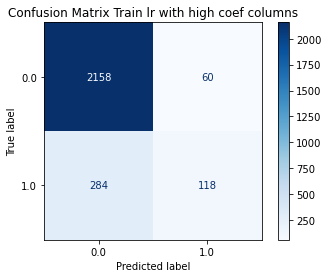

In [579]:
plot_conf_matrix_func(logistic_reg_for_validate,"lr with high coef columns",X_val_.T,y_validation,a)

Plot of confusion matrix for logistic regression but we tried other appoach, with high coefficient  we get 118 true positives, less then in the original moodel.

In [580]:
plot_roc_curve_func(y_validation,logistic_reg_for_validate.predict_proba(X_val_.T)[:,1],"lr with high coef columns")

We saw to our surpise that the  choosing high coefficient columns as train can over fit more and give lower true positive rate. We got Auc =0.83 good result for auc.

<h3>K-Nearest Neighbours</h3>

*checks the accuracy for various values of n for K-Nearest nerighbours*

In [581]:
index_list=list(range(1,20,2))
a=pd.Series()
for i in index_list:
    Kkn_model=KNeighborsClassifier(n_neighbors=i) 
    Kkn_model.fit(X_train.astype('float64'),y_train.astype('float64'))
    Y_prediction=Kkn_model.predict(X_validation.astype('float64'))
    a=a.append(pd.Series(accuracy_score(Y_prediction.astype('float64'),y_validation.astype('float64'))))
pltx.line(x=index_list,y=a,title="N neighbors by accuracy score")


This plot shows the predicted accuracy for different numbers of neighbors , we can see that the higher the number the accuracy changes by 0.01. We got 3 in the gridsearch, and decided to go with it 

In [582]:
knn_param = {}
knn_param["n_neighbors"] = [3,5,7,11]
knn_param["weights"] = ['uniform','distane']
knn_param["algorithm"] = ['auto','ball_tree','kd_tree','brute']
knn_cv = GridSearchCV(KNeighborsClassifier(),param_grid=knn_param,scoring=accuracy_score,cv = 30)
knn_cv.fit(X_train,y_train)

GridSearchCV(cv=30, estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'n_neighbors': [3, 5, 7, 11],
                         'weights': ['uniform', 'distane']},
             scoring=<function accuracy_score at 0x7f8a59b11b80>)

In [583]:
knn_cv.best_params_ 

{'algorithm': 'auto', 'n_neighbors': 3, 'weights': 'uniform'}

*The grid search showed that  3 is the best number of nighbors. But the plot of explaind variance showeed that n = 11 has the highest accuracy score.<br>
We obsorbed lowe auc value and lowe roc graph for n = 3, so we chose the knn model with n=11.*

In [584]:
knn = KNeighborsClassifier(**knn_cv.best_params_)
knn.fit(X_train.astype('float64'),y_train.astype('float64'))
y_score_knn = knn.predict_proba(X_validation)[:, 1]
prediction_knn=knn.predict(X_validation.astype('float64'))  
knn_auc = accuracy_score(prediction_knn.astype('float64'),y_validation.astype("float64"))
print('The accuracy of the KNN is:',accuracy_score(prediction_knn,y_validation.astype("int")))

The accuracy of the KNN is: 0.8412213740458016


In [585]:
Kfolds_best_n(knn,X_train,y_train,X_validation,y_validation)

('5', 0.8412213740458016)

In [586]:
cross_validaion_best_cv(knn,X_train,y_train)

('19', 0.8456553444530018)

In [587]:
fig = pltx.scatter(
    X_validation, x=0, y=1,
    color=y_score_knn, color_continuous_scale='blues',
    symbol=y_validation, symbol_map={'0': 'square-dot', '1': 'circle-dot'},
    labels={'symbol': 'label', 'color': 'score of <br>first class'},
    title="3 Nearest Neighbors Classificatio plot"
)
fig.update_traces(marker_size=12, marker_line_width=1.5)
fig.update_layout(legend_orientation='h')
fig.update_layout(autosize=False,width=800,height=800,)
fig.show()

 
This plot shows the distribution of predicted values with 3 nearest neighbors, we can see a group of x that were classified as 1, purchase, and their closest neighbor are more bule.</br>
The white observations are zero and we can see that their neighbor are also white. 
We can see miss  classified point of ‘0’ as ‘1’ in the top conner becauese his neighbors are 1.
The points look very close to each other and maby that couses over fitting.


In [588]:
fig = pltx.scatter_3d(
    X_validation, x=0, y=1,z=1,
    color=y_score_knn, color_continuous_scale='blues',
    symbol=y_validation, symbol_map={'0': 'square-dot', '1': 'circle-dot'},
    labels={'symbol': 'label', 'color': 'score of <br>first class'},
    title='3 Nearest Neighbors 3D'
)
fig.update_traces(marker_size=6, marker_line_width=2)
fig.update_layout(legend_orientation='h')
fig.update_layout(autosize=True,width=800,height=800)
fig.show()

This plot is the smae as the one before but we can see how close and daese the values are. Might help us see why this model has such low auc (the daese the values are)

In [589]:
from sklearn.model_selection import cross_validate, cross_val_predict
fig = pltx.line()

Cross_val_knn = cross_val_score(knn,X_train ,y_train,cv=18)
pltx.line(Cross_val_knn,title="Cross validation with cv=18 arguments")

Here we can see the cross validation scores for 18 folds,we got the value from a function that finds best k folds by comparing accuracies.
We can see that the highest one is index 5 with 0.86.

In [590]:
Cross_val_knn

array([0.85812357, 0.85354691, 0.84897025, 0.81464531, 0.82608696,
       0.86270023, 0.84210526, 0.84210526, 0.84897025, 0.83981693,
       0.84668192, 0.86009174, 0.8440367 , 0.83715596, 0.84633028,
       0.85091743, 0.84633028, 0.83256881])

In [591]:
mse_knn = mean_squared_error(y_validation,prediction_knn)

0.8412213740458016 accuracy


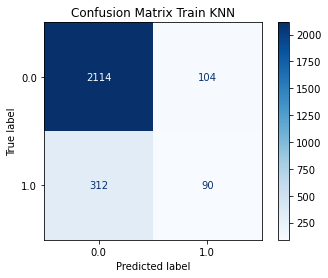

In [592]:
plot_conf_matrix_func(knn ,"KNN",X_validation,y_validation,knn_auc)

Plot of confusion matrix for knn, we need that to see the number of true positives and true negatives , this is one of the ways to see how many values were predicted right.
There are 90 true predictions , and 312 that the model classified wrong an not purchse. And 104 that were 0 but the qlassification is 1.
This model preforming poorly and more likly to be overfit (the scatter plot).

In [593]:
plot_roc_curve_func(y_validation,y_score_knn,"KNN")

The auc here is very low at 0.68, mean the model predicts rigth only 68% of the time.

<h3>Support Vector Machine (SVM)</h3>

We desided not to include 'precomputed' in kernel because the matrix should be n•n

In [594]:
svmdict = {}
svmdict['C'] = [0.5,1.0,10.0,15]
svmdict['kernel'] = ['linear','poly','sigmoid']
svm_cv = GridSearchCV(svm.SVC(),svmdict)
svm_cv.fit(X_train,y_train)

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.5, 1.0, 10.0, 15],
                         'kernel': ['linear', 'poly', 'sigmoid']})

In [595]:
svm_cv.best_params_

{'C': 10.0, 'kernel': 'linear'}

In [596]:
model_svm = svm.SVC(**svm_cv.best_params_, probability=True)
model_svm.fit(X_train.astype('float64'),y_train.astype('float64'))
prediction_svm=model_svm.predict(X_validation.astype('float64')) 
y_score_svm=model_svm.predict_proba(X_validation.astype('float64')) 
svm_auc = accuracy_score(y_validation,prediction_svm)
print('The accuracy of the SVM is:',svm_auc)

The accuracy of the SVM is: 0.8904580152671756


In [597]:
model_svm.support_vectors_.shape

(2003, 41)

*We dont use the function because of run time and do the defolt with suffle*

In [598]:
kf = KFold(shuffle=True,random_state=random_state)
kf.split(X_train,X_train)
model_svm.fit(X_train,y_train)
pred = model_svm.predict(X_validation)
acc = accuracy_score(y_validation,pred)
acc

0.8904580152671756

0.8904580152671756 accuracy


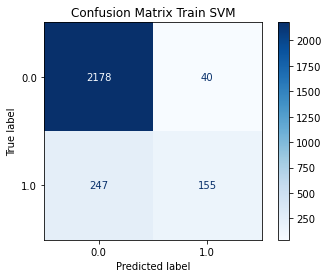

In [599]:
plot_conf_matrix_func(model_svm,"SVM",X_validation,y_validation,svm_auc)

The SVM confusion matrix represents 155True positive results, with 89% accuracy . In contrast, the SVM model predicts 246 True negative. Our precision-recall tradeoff curve for SVm is 0.67


In [600]:
max(cross_val_score(model_svm,X_validation,y_validation))

0.9007633587786259

In [601]:
def remove_col_return_tp(i,model):
    l = {}
    xt =X_train.copy()
    xt = np.delete(xt,i,1)
    xv = X_validation.copy()
    xv = np.delete(xv,i,1)

    model.fit(xt,y_train)
    try_pred = model.predict(xv)
    a = accuracy_score(y_validation,try_pred)
    print(a,i)
    l[i]=confusion_matrix(y_validation,try_pred)[1,1]
    return l
    

In [602]:
plot_roc_curve_func(y_validation,prediction_svm,"SVM")

The auc of svm  here is very low at 0.68, mean the model predicts rigth only 68% of the time.We saw the confusion matrix had alot of miss classified points.
We think that svm model might not be the best choise for this data set.


In [603]:
model_svm.support_vectors_.shape

(2003, 41)

In [604]:
mse_svm = mean_squared_error(y_validation,prediction_svm)

In [605]:
model_svm.support_vectors_.shape

(2003, 41)

In [606]:
pltx.scatter_3d(x=range(0,model_svm.support_vectors_.shape[0]),y=model_svm.support_vectors_[:,1],z=range(0,model_svm.support_vectors_.shape[0]),color=prediction_svm[:model_svm.support_vectors_.shape[0]])

Since we have 2003 support vectors, it is hard to plot so we ploted the suport vector it index 1 and the color is the purchase.
We can see how dense the points are and that might effect the abilty of the support vector to separate the data.

*This function removes column with low coef and cheakes if the number of tp values is better*

In [607]:
pltx.bar(x=range(0,model_svm.coef_.shape[1]),y=model_svm.coef_[0,:],title='SVM Coefficient -Feature Importance')

SVM coefficient
From our feature importance plot bar, it seems that feature 31 has a negative effect of about -0.5, while feature 34 has a positive effect of about 0.4.
feature 9, 12, 13, 33 appears to have very little effect on the SVM model. 
 


In [608]:
def remove_col_return_tp(i,model):
    l = {}
    xt =X_train.copy()
    xt = np.delete(xt,i,1)
    xv = X_validation.copy()
    xv = np.delete(xv,i,1)
    model.fit(xt,y_train)
    try_pred = model.predict(xv)
    a = accuracy_score(y_validation,try_pred)
    print(a,i)
    l[i]=confusion_matrix(y_validation,try_pred)[1,1]
    return l
    

In [609]:

print(remove_col_return_tp(33,model_svm))
print(remove_col_return_tp(9,model_svm))



0.8900763358778626 33
{33: 154}
0.8904580152671756 9
{9: 155}


*We tried to remove columns with low coefficient and for removing column 33 we got 154 tp </br>
(less then the original). and for 9  155 tp (same)*

<h3>Random Forest </h3>

In [610]:
dt=RandomForestClassifier()
param_grid={
    'criterion':['gini','entropy'],
    'max_depth':np.arange(4,10,1),
    'min_samples_split':np.arange(0.001,0.1,0.01),
    'max_features':['log2','sqrt','auto'],
    'min_weight_fraction_leaf':np.arange(0.001,0.20,0.05),
    'n_estimators': np.arange(50,250,50)
}
r_search=RandomizedSearchCV(dt,param_distributions=param_grid,n_iter=50,verbose=1,n_jobs=15)
r_search.fit(X_train,y_train)
r_search.best_params_

Fitting 5 folds for each of 50 candidates, totalling 250 fits


{'n_estimators': 100,
 'min_weight_fraction_leaf': 0.001,
 'min_samples_split': 0.001,
 'max_features': 'sqrt',
 'max_depth': 9,
 'criterion': 'entropy'}

In [611]:
randomFor= RandomForestClassifier(**r_search.best_params_)
randomFor.fit(X_train,y_train)
randomFor_prediction = randomFor.predict(X_validation)
y_score_randomFor_prediction = randomFor.predict_proba(X_validation)[:,1]
randomForest_auc =accuracy_score(y_validation,randomFor_prediction)
randomForest_auc

0.8706106870229008

<bound method Figure.show of <Figure size 2160x2160 with 1 Axes>>

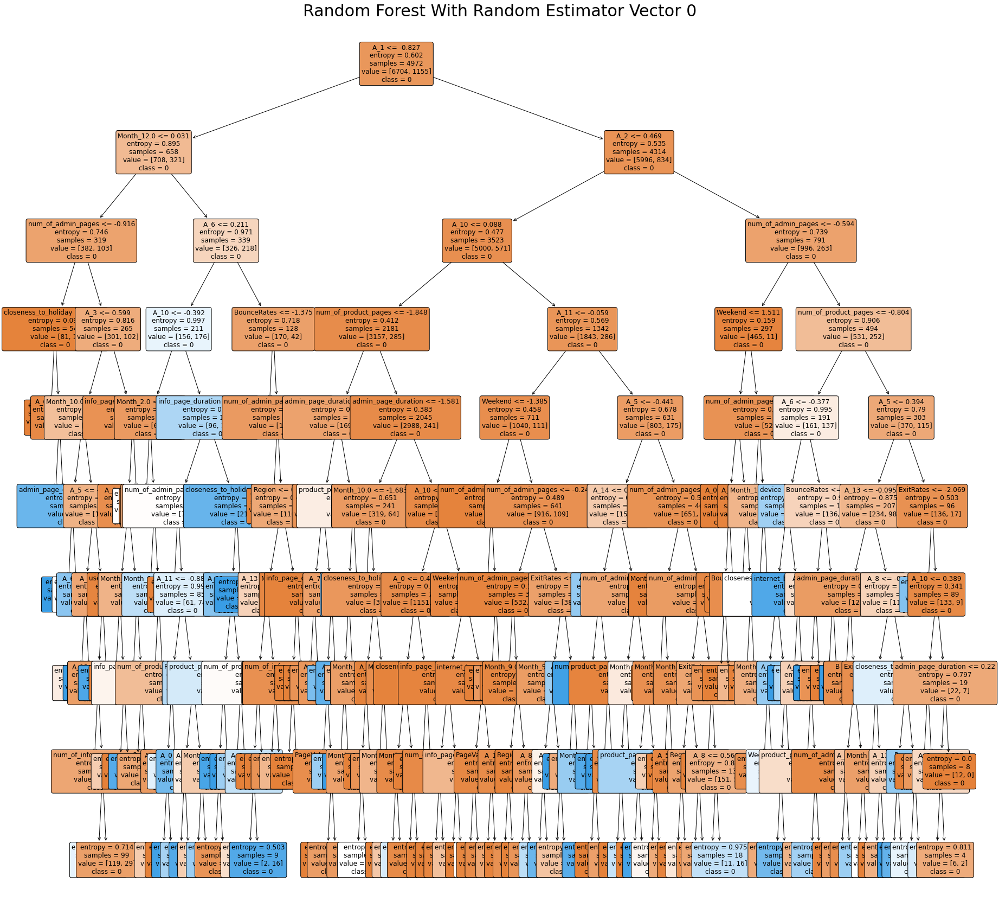

In [612]:
from sklearn.tree import plot_tree
fig = plt.figure(figsize=(30, 30))
plot_tree(randomFor.estimators_[0], 
        feature_names=data.columns,
        class_names= y.astype("str"), 
        filled=True, impurity=True, 
        rounded=True,
        fontsize=12) 
plt.title("Random Forest With Random Estimator Vector 0",fontsize = 30)

fig.show

Random Forest Tree
Our random forest model starts with the feature 'Month 10.0' (Novembar) as the root feature in our '0' index - initial tree, with a 59 percent separation between the sides.</br>
This attribute has a positive impact on our predicted outcome and can readily assist the model in getting started. The second layer is the A 5 feature, about whom we know very little (unknown variable).</br>
On this tree, we have 7 layers between the root and his leaves.
 



<bound method Figure.show of <Figure size 2880x2880 with 1 Axes>>

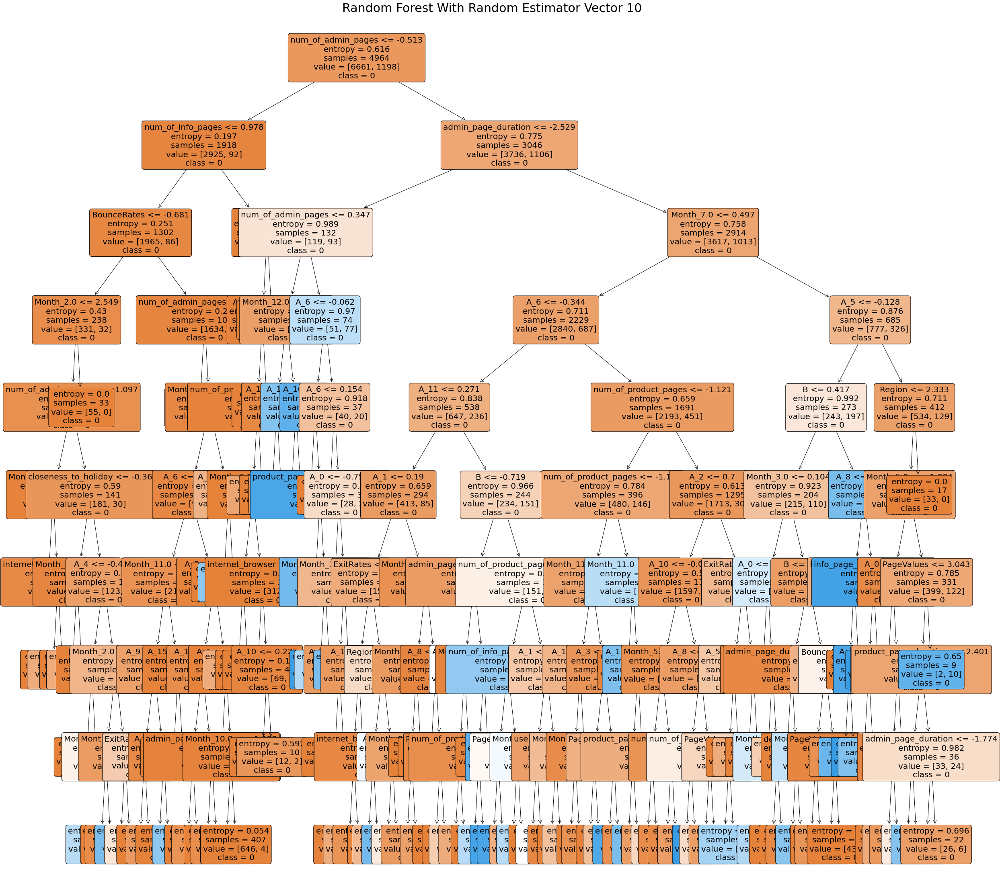

In [613]:
import random
i = random.randint(1,10)
fig = plt.figure(figsize=(40, 40))
plot_tree(randomFor.estimators_[i], 
        feature_names=data.columns,
        class_names= y.astype("str"), 
        filled=True, impurity=True, 
        rounded=True, fontsize=20) 
plt.title("Random Forest With Random Estimator Vector "+str(i),fontsize=30)
fig.show

We ploted 2 trees. one of estimator 0 and one of a random estimator,We can observe that most classes were 0, but we added to see how it preforms in other estimatores.
Since it is generated by random we wont know what values will appear.


*This function removes column with low coef and cheakes if the number of tp values is better*

In [614]:
mse_rf = mean_squared_error(y_validation,randomFor_prediction)

In [615]:
randomFor.feature_importances_.shape[0]

41

In [616]:
max(cross_val_score(randomFor,X_validation,y_validation))

0.8778625954198473

In [617]:
pltx.bar(x=[range(0,randomFor.feature_importances_.shape[0])],y=randomFor.feature_importances_,title="Feature Importance In Random Forest")

Random Forest feature importance 
Our important features vary from 0 to 0.18, with feature '0' and feature '34' having values more than 0.15, and feature 11 having the least impact on tree separation.


0.8706106870229008 accuracy


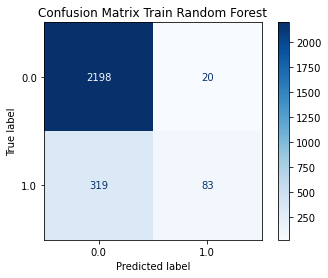

In [618]:
plot_conf_matrix_func(randomFor,"Random Forest",X_validation,y_validation,randomForest_auc)

Random Forest Confusion matrix. 
On the Random Forest Confusion Matrix, the model predicts 58 True positives, but Ture negative is greater than the other models, implying that the model correctly predicts that the user did not buy.


In [619]:
plot_roc_curve_func(y_validation,y_score_randomFor_prediction,"Random Forest")

Random forest ROC curve
Our model has an AUC of 84 percent, which implies it has a moderate classification accuracy of 84 percent and can distinguish effectively between positive and negative classifications.


In [620]:
k= Kfolds_best_n(randomFor,X_train,y_train,X_validation,y_validation)
print(k)

('11', 0.8732824427480916)


<h2>Project Evaluation </h2>

<h4>Area Under The Curve (AUC)</h4>

The area under the ROC curve indicates how accurate the model is at identifying members of the training dataset; the larger the area, the bigger the difference between true and false positives, and the better the model is at classifying members of the training dataset. A model with an area of 0.5 performs no better than random categorization, and a smart classifier avoids this as much as possible. A surface area of one is excellent. The AUC should be as near to 1 as possible.

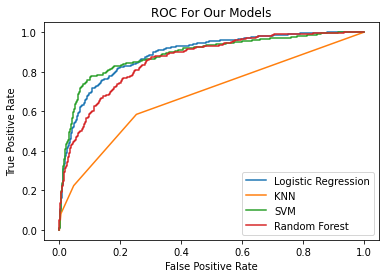

In [621]:
yscors = [y_scoure_logreg,y_score_knn,y_score_svm[:,1],y_score_randomFor_prediction]
labels = ["Logistic Regression","KNN","SVM","Random Forest"]
for i in range(0,4):
    fpr, tpr, thresholds = roc_curve(y_validation, yscors[i])
    plt.plot(fpr,tpr,label=labels[i])
plt.title("ROC For Our Models")
plt.legend()
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.show()

<h4> We can see that
We can see, that three models are close to each other (exept knn). As we mentioned before about the  importance of the auc,we know that logistic regression predicted the most true positives, but to be sure to choose the better model we will look on classification report.</h4>

In [622]:
mse_df = [['logistic',mse_lr],['knn',mse_knn],['svm',mse_svm],['rf',mse_rf]]
mse_df = pd.DataFrame(mse_df ,columns =['Model','MSE'])
pltx.bar(mse_df,x='Model',y='MSE',color='MSE',width=600,height=400,title="MSE Of Our Models")


From this plot we can observe that most of our modles have low mse. As for evaluating parameter, we see that logictic regression showes lower value than other
models.</br>
That supports our decision to choosethe logistic model.

In [623]:
r2 = {}
r2['logistic']=R2(y_validation,y_pred_val)
r2['knn']=R2(y_validation,prediction_knn)
r2['svm']=R2(y_validation,prediction_svm)

r2['Random Forest']=R2(y_validation,randomFor_prediction)

In [624]:
r2=pd.DataFrame(r2,index=[1])
r2

,logistic,knn,svm,Random Forest
1,0.130228,-0.222382,0.156674,0.003876


In [625]:

pltx.bar(x=r2.columns,y=r2.values[0],title="R^2 Score By Model",color=r2.values[0] ,width=600, height=500)

 
*R^2 coefficient presents the goodness of fit of the model. But, since most of our models are not linear and linearly separable only in some features, we don't
focus on it that much.*


In [626]:
def report(predicion):
    return classification_report(y_validation,predicion,labels=[0,1],output_dict=True)
rep_logreg = report(y_pred_val)
rep_knn = report(prediction_knn)
rep_svm = report(prediction_knn)
rep_rf = report(randomFor_prediction)   

In [627]:
rep_knn['1']

{'precision': 0.4639175257731959,
 'recall': 0.22388059701492538,
 'f1-score': 0.30201342281879195,
 'support': 402}

In [628]:

p = pd.DataFrame([rep_logreg['1'],rep_knn['1'],rep_svm['1'],rep_rf['1']],['logistic reg','knn','svm','rf'])


In [629]:
fig = pltl.Figure(data=[pltl.Bar(name='precision',x=p.index,y=p['precision']),
                        pltl.Bar(name='recall',x=p.index,y=p['recall']),
                        pltl.Bar(name='f1-score',x=p.index,y=p['f1-score'])]
                        )
fig.update_layout(title='classification Report By Models For lebal=1')
fig.show()


<h5 > This graph summarizes the classification report; we can see that out of all the models, logistic regression has the best three parameters.</br>
 Although random forest has the highest accuracy, it also has the best recall and f1. SVM and KNN have similar properties and have a low AUC. </h5>

<h5> The logistic regression model is our top performer, with a high auc and precsision. </5>

<h3>Final Pipline </h3>

*We have here all the needed functions to preforme the pipeline, so we expect that you run from here(imorts) down, so the functions are existing.</br>And at the end there is the implementation of the pipline*

In [630]:
import pandas as pd
import numpy as np
import csv
from numpy import nan
from typing import List, Dict
import math
import warnings
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
import warnings
from pandas.core.common import SettingWithCopyWarning


In [631]:
from pandas.core.common import SettingWithCopyWarning

warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

In [632]:
def create_d(y_test_score_lr):
    d={}
    for i in range(y_test_score_lr.shape[0]):
        d[i]=y_test_score_lr[:,1][i]
    return d
    

In [633]:
def create_final_submission(test_proba):
    a_file = open("Submission_group_37.csv", "w")
    a_dict = create_d(test_proba)
    writer = csv.writer(a_file,)
    writer.writerow(['id','predict_prob'])
    for key, value in a_dict.items():
        writer.writerow([key, value])
    a_file.close()
    pass

In [634]:
#for pipeline
def read(filename):
    return pd.read_csv(filename)



In [635]:
#for pipeline
def create_y(d):
      return d.values[:,-1]
def create_X(d):
      return d.values


In [636]:
#for pipeline 
def get_dum(d,col):
    return pd.get_dummies(d,columns=[col])


In [637]:
#for pipeline
def month(d):
    d.replace({"May":5,"Nov":11,"Dec":12,"Oct":10,"Sep":9,"Jul":7,"Aug":8,"June":6,"Feb":2,"Mar":3},inplace=True)
    d['Month'].replace(nan,7,inplace=True)
    return pd.get_dummies(d,columns=['Month'])


In [638]:
def fill_NA_by_mean(data):
    col_fillna_mean = ['num_of_info_pages', 'num_of_product_pages', 'num_of_admin_pages']
    for i in col_fillna_mean:
        data[i] = data[i].fillna(data[i].mean())
    return data
def fill_NA_by_zero(data):    
    col_fillna_0 = ['info_page_duration','internet_browser','device','A', 'closeness_to_holiday', 'admin_page_duration', 'product_page_duration','Weekend','user_type']
    for i in col_fillna_0:
        data[i] = data[i].fillna(0)
    return data


def replace_NA_by_mean(data):
    col_repna_mean = ['BounceRates','B','ExitRates','PageValues']
    for i in col_repna_mean:
        data[i].replace( np.nan, np.mean(data[i]),inplace=True)
    return data
        
def fill_NA_for_Region(data):
    data['Region'].fillna((data['Region'].median()),inplace=True)#the only one so we dont need a loop
    return data



In [639]:
def remove_str_col_A (filename,df):
    data_copy=pd.read_csv(filename)
    lst_to_md_A=[]
    for i in range(len(data_copy['A'])):
        if data_copy['A'][i] is not nan :
            a=int(data_copy['A'][i].split('_')[1])
            df['A'][i]=a
            lst_to_md_A.append(a)

        else:
            i+=1
    df['A']=df['A'].fillna(np.median(lst_to_md_A))
    return  df


In [640]:
def remove_str_col_C(filename,df):
    data_copy=pd.read_csv(filename)
    for i in range(len(data_copy['C'])):
        if df['C'][i] is not nan and data_copy['C'][i]!="log_100":
            a=int(data_copy['C'][i].split('g')[1])
            df['C'][i]=a

        elif data_copy['C'][i]=="log_100":
            a=int(data_copy['C'][i].split('_')[1])
            df['C'][i]=a

        else:
            i+=1
    median_C=np.median(df['C'])
    df['C'].replace(np.nan,median_C,inplace=True)
    return df

In [641]:
def remove_minutes(filename,df,col ):
    duration_product_no_word_mints=[]
    data_copy = pd.read_csv(filename)
    for i in range(len(data_copy[col])):
        lst_to_count_mean = []
        if type(data_copy[col][i]) is str:
            a = (data_copy[col][i].split())[0]
            lst_to_count_mean.append(float(a)) 
            df[col][i] = a
        else:
            i += 1
    arr = np.array(lst_to_count_mean)
    mean_time = np.mean(lst_to_count_mean)
    return df[col].replace( np.nan, mean_time,inplace = True)
    





In [642]:
#for pipeline
def drop(col,dt):
    dt.drop(labels=[col],axis=1,inplace=True) 
    pass
    

In [643]:
#for pipeline
def weekend(d):
    d.Weekend.replace({False: 0, True: 1}, inplace=True)
    
    return d
    


In [644]:
#for pipeline
def user(d):
    d['user_type'].replace({"Returning_Visitor":1,"New_Visitor":0,"Other":1},inplace=True)
    return d
    

In [645]:
def admin_page_ouliers(d):
    d["admin_page_duration"] = np.where(d["admin_page_duration"] >6*60, d['admin_page_duration'].mean(),d['admin_page_duration'])
    admin_page_duration_after_calc=d[['admin_page_duration']].melt()
    return admin_page_duration_after_calc['value'].astype(str).astype(float)

In [646]:
def isfloat(num):
    try:
        float(num)
        return True
    except ValueError:
        return False

def browser_to_num(df):    
    for i in range(len(df['internet_browser'])):
        if df['internet_browser'][i] is not None and isfloat(df['internet_browser'][i]) is False:
            word = df['internet_browser'][i].split('_')[0]
            if word == 'chrome':
                df['internet_browser'][i] = 1
            else:
                df['internet_browser'][i] = 0
        else:
            i+=1
    
    return df

In [647]:
#for pipeline
def split_tr_vl(XX,yy):
    X_train, X_validation, y_train, y_validation = train_test_split(XX,yy, test_size=0.2, random_state=42)
    return X_train, X_validation, y_train, y_validation


In [648]:
#pipeline
def pca_func(XX,xtst):
    pca = PCA(n_components=42)
    Xpca = pca.fit_transform(XX)
    X_test = pca.transform(xtst)
    return Xpca,X_test

In [649]:
#pipeline our model
def fit_model_predict(xt,yt,tst):
    lg = LogisticRegression(C=10.1,solver='newton-cg',random_state=1,n_jobs=-1)
    lg.fit(xt.astype('float64'),yt.astype('float64'))#our parmeters and best model
    prediction_proba = lg.predict_proba(tst.astype('float64'))
    return prediction_proba


In [650]:
#for pipeline
def stndr_befor_pca(X,Xtst):
    stc = StandardScaler()
    X=stc.fit_transform(X)
    X_test = stc.transform(Xtst)
    return X,X_test

In [651]:
def pipline(tr,ts):

    data = read(tr)
    data_test = read(ts)
    y = create_y(data)

    drop('id',data)
    drop('D',data)   
    drop('total_duration',data)
    drop('purchase',data)
    admin_page_ouliers(data)
    data = month(data)
    fill_NA_by_mean(data)
    fill_NA_by_zero(data)
    fill_NA_for_Region(data)
    replace_NA_by_mean(data)
    weekend(data)
    remove_minutes(tr,data,'product_page_duration')
    remove_minutes(tr,data,'info_page_duration')
    browser_to_num(data)
    user(data)
    remove_str_col_A(tr,data)
    data = get_dum(data,'A')
    remove_str_col_C('train.csv',data)
    data = get_dum(data,'C')
    drop('A_16',data) 
    drop('A_17',data)


    drop('id',data_test)
    drop('D',data_test) 
    drop('total_duration',data_test)
    admin_page_ouliers(data_test)
    data_test = month(data_test)
    fill_NA_by_mean(data_test)
    fill_NA_by_zero(data_test)
    fill_NA_for_Region(data_test)
    replace_NA_by_mean(data_test)
    weekend(data_test)
    remove_minutes(ts, data_test,'product_page_duration')
    remove_minutes(ts,data_test,'info_page_duration')
    browser_to_num(data_test)
    user(data_test)
    remove_str_col_A(ts,data_test)
    data_test = get_dum(data_test,'A')
    remove_str_col_C(ts,data_test)
    data_test = get_dum(data_test,'C')
    drop('A_12',data_test)

    X = create_X(data)
    X_test= create_X(data_test)
    stndr_befor_pca(X,X_test)
    Xpca,X_test= pca_func(X,X_test)
    X_train,X_validation,y_train,y_validation=train_test_split(Xpca,y,test_size=0.2,random_state=42,shuffle= True)
    prediction_proba= fit_model_predict(X_train,y_train,X_test).astype('float64')
    create_final_submission(prediction_proba)

      

In [652]:
pipline('train.csv','test.csv')
